# 1. Introduction

<b><u>Graded Challenge 7 </u></b>

Nama : Muhammad Azhar Khaira

Batch : RMT-033

Dataset : [From Kaggle](https://www.kaggle.com/datasets/khananikrahman/is-an-employee-wearing-safety-gear)

Objectives:

Project kali ini bertujuan untuk membuat model computer vision yang mampu mendeteksi dan mengidentifikasi apakah pekerja di lapangan menggunakan perlengkapan keselamatan atau tidak. Model ini bisa digunakan untuk mengevaluasi kedisiplinan pekerja dalam penggunaan perlengkapan keselamatan dan mendukung pengambilan keputusan guna mencegah kecelakaan kerja akibat kelalaian. Dalam mengevaluasi performa model menggunakan akurasi untuk mengukur keseluruhan kebenaran prediksi model, loss untuk menilai seberapa jauh prediksi model dari nilai sebenarnya.

# 2. Import Libraries

In [407]:
# import libraries
import os
import glob
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image, ImageEnhance
from sklearn.cluster import KMeans
import matplotlib.colors as mcolors
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Dropout, GlobalAveragePooling2D
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from tensorflow.keras.applications import MobileNetV2
from sklearn.metrics import classification_report, confusion_matrix


# 3. Data Loading

In [2]:
# rename files in the "wearing-safety-gear" category
wear_sg = glob.glob("GearedorNot/Wearing Safety Gear/*")
num = 1
for wsg in wear_sg:
    file_name, file_ext = os.path.splitext(wsg)
    new_name = "GearedorNot/Wearing Safety Gear/wearsg_" + "{:03d}".format(num) + file_ext
    os.rename(wsg, new_name)
    num += 1

# rename files in the "not-wearing-safety-gear" category
notwear_sg = glob.glob("GearedorNot/Not Wearing Safety Gear/*")
num = 1
for nwsg in notwear_sg:
    file_name, file_ext = os.path.splitext(nwsg)
    new_name = "GearedorNot/Not Wearing Safety Gear/notwearsg_" + "{:03d}".format(num) + file_ext
    os.rename(nwsg, new_name)
    num += 1

In [351]:
# list and length images of each category
wear_sg = glob.glob("GearedorNot/Wearing Safety Gear/*")
notwear_sg = glob.glob("GearedorNot/Not Wearing Safety Gear/*")

# sort list
wear_sg.sort()
notwear_sg.sort()

print("Wear Safety Gear : ", wear_sg)
print(f"Total Images    : {len(wear_sg)}")
print("")
print("Not Wear Safety Gear : ", notwear_sg)
print(f"Total Images    : {len(notwear_sg)}")

Wear Safety Gear :  ['GearedorNot/Wearing Safety Gear/wearsg_001.jpeg', 'GearedorNot/Wearing Safety Gear/wearsg_002.jpeg', 'GearedorNot/Wearing Safety Gear/wearsg_003.jpg', 'GearedorNot/Wearing Safety Gear/wearsg_004.jpeg', 'GearedorNot/Wearing Safety Gear/wearsg_005.jpg', 'GearedorNot/Wearing Safety Gear/wearsg_006.jpeg', 'GearedorNot/Wearing Safety Gear/wearsg_007.jpg', 'GearedorNot/Wearing Safety Gear/wearsg_008.jpeg', 'GearedorNot/Wearing Safety Gear/wearsg_009.jpg', 'GearedorNot/Wearing Safety Gear/wearsg_010.jpeg', 'GearedorNot/Wearing Safety Gear/wearsg_011.jpeg', 'GearedorNot/Wearing Safety Gear/wearsg_012.jpg', 'GearedorNot/Wearing Safety Gear/wearsg_013.jpeg', 'GearedorNot/Wearing Safety Gear/wearsg_014.jpg', 'GearedorNot/Wearing Safety Gear/wearsg_015.jpeg', 'GearedorNot/Wearing Safety Gear/wearsg_016.jpeg', 'GearedorNot/Wearing Safety Gear/wearsg_017.jpeg', 'GearedorNot/Wearing Safety Gear/wearsg_018.jpg', 'GearedorNot/Wearing Safety Gear/wearsg_019.jpg', 'GearedorNot/Weari

In [352]:
# create dataframe contains path of all images
all_files = wear_sg + notwear_sg
labels = ["wear" for i in range(len(wear_sg))] + ["notwear" for i in range(len(notwear_sg))]
df_img = pd.DataFrame({"images":all_files, "label":labels})
df_img = df_img.sample(len(df_img)).reset_index(drop=True)
df_img

,images,label
0,GearedorNot/Wearing Safety Gear/wearsg_024.jpeg,wear
1,GearedorNot/Not Wearing Safety Gear/notwearsg_...,notwear
2,GearedorNot/Not Wearing Safety Gear/notwearsg_...,notwear
3,GearedorNot/Wearing Safety Gear/wearsg_093.jpg,wear
4,GearedorNot/Not Wearing Safety Gear/notwearsg_...,notwear
...,...,...
350,GearedorNot/Wearing Safety Gear/wearsg_036.jpeg,wear
351,GearedorNot/Not Wearing Safety Gear/notwearsg_...,notwear
352,GearedorNot/Not Wearing Safety Gear/notwearsg_...,notwear
353,GearedorNot/Wearing Safety Gear/wearsg_117.jpeg,wear


## 3.1. Wear Safety Gear Images

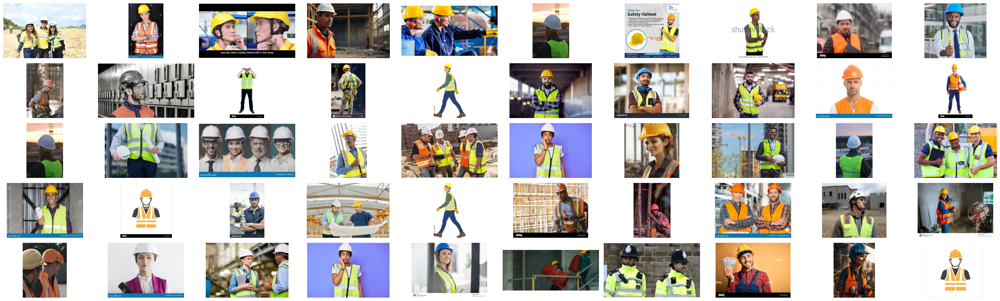

In [247]:
# show wear safety gear images
num_cols = 10
num_rows = 5
num_wear_sg_img = len(wear_sg)

fig, ax = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(30, 9))

for i in range(num_rows):
    for j in range(num_cols):
        img_idx = i * num_cols + j
        if img_idx < num_wear_sg_img:
            wsg = plt.imread(wear_sg[img_idx])
            ax[i, j].imshow(wsg)
            ax[i, j].axis("off")
        else:
            ax[i, j].axis("off")

plt.tight_layout()
plt.show()


## 3.2. Not Wear Safety Gear Images

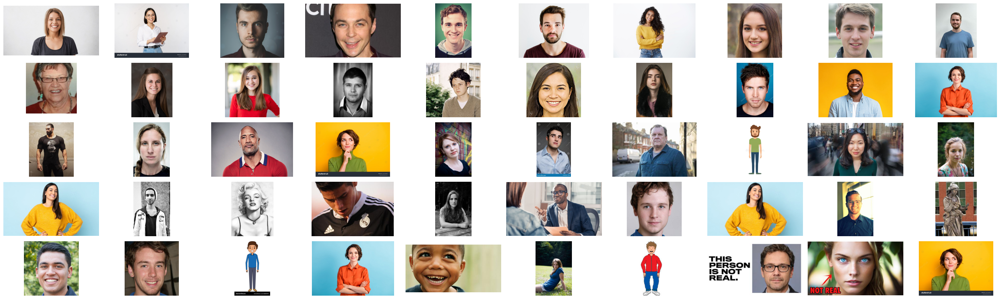

In [248]:
# show not wear safety gear images
num_notwear_sg_images = len(notwear_sg)

fig, ax = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(30, 9))

for i in range(num_rows):
    for j in range(num_cols):
        img_idx = i * num_cols + j
        if img_idx < num_notwear_sg_images:
            wsg = plt.imread(notwear_sg[img_idx])
            ax[i, j].imshow(wsg)
            ax[i, j].axis("off")
        else:
            ax[i, j].axis("off")

plt.tight_layout()
plt.show()


## 3.3. Loading Images with TensorFlow

In [274]:
# takes path to a directory & generates batches
IMG_SIZE = 224
path = "GearedorNot/"

datagen = tf.keras.preprocessing.image.ImageDataGenerator()
data = datagen.flow_from_directory(path, (IMG_SIZE, IMG_SIZE), batch_size=256, class_mode="binary", shuffle=True)
data

Found 355 images belonging to 2 classes.


insight:
- terdapat 355 gambar yang terbagi menjadi 2 kelas

In [275]:
# show images in pixel form
print("Images : ", data[0][0])
print("Shape  : ", data[0][0].shape)

Images :  [[[[129. 131. 128.]
   [128. 130. 129.]
   [128. 129. 131.]
   ...
   [122. 127. 130.]
   [117. 122. 126.]
   [ 91.  94.  99.]]

  [[124. 125. 127.]
   [122. 123. 127.]
   [122. 123. 128.]
   ...
   [130. 135. 138.]
   [123. 128. 132.]
   [ 99. 102. 107.]]

  [[121. 122. 127.]
   [119. 119. 127.]
   [118. 118. 128.]
   ...
   [131. 136. 139.]
   [123. 128. 132.]
   [ 98. 101. 106.]]

  ...

  [[ 73.  88.  83.]
   [ 72.  89.  81.]
   [ 73.  90.  80.]
   ...
   [127. 139. 139.]
   [126. 137. 139.]
   [ 96. 105. 110.]]

  [[ 72.  89.  83.]
   [ 72.  89.  83.]
   [ 74.  89.  84.]
   ...
   [129. 141. 141.]
   [129. 139. 141.]
   [ 99. 104. 110.]]

  [[ 72.  89.  83.]
   [ 72.  89.  83.]
   [ 74.  89.  84.]
   ...
   [127. 139. 139.]
   [127. 137. 139.]
   [ 97. 102. 108.]]]


 [[[181. 194. 229.]
   [182. 194. 234.]
   [187. 196. 229.]
   ...
   [145. 185. 254.]
   [145. 185. 254.]
   [145. 185. 254.]]

  [[175. 189. 234.]
   [182. 197. 238.]
   [181. 194. 236.]
   ...
   [145. 18

insight:
- dalam 1 batch ada 256 gambar dan setiap gambar berukuran 224 x 224 pixel dan memiliki 3 color chanel (RGB)

In [251]:
# show classes
print("Class  : ", data[0][1])
print("Shape  : ", data[0][1].shape)

Class  :  [1. 0. 1. 1. 0. 0. 1. 0. 1. 0. 0. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 0. 0. 1.
 0. 0. 1. 0. 1. 0. 1. 0. 1. 0. 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 0.
 1. 0. 1. 1. 0. 1. 1. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0.
 1. 0. 0. 1. 1. 1. 1. 0. 1. 1. 0. 0. 1. 0. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 1. 0. 0. 1. 0. 0. 0. 1. 1. 1. 0. 0. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1.
 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 0. 1. 1.
 0. 0. 1. 0. 1. 1. 0. 1. 0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 1. 0. 0. 0.
 0. 0. 0. 1. 0. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 1. 0. 0.
 0. 0. 1. 1. 0. 1. 0. 0. 0. 1. 1. 0. 1. 0. 1. 0. 0. 1. 0. 0. 1. 1. 0. 0.
 0. 0. 0. 0. 1. 0. 0. 1. 1. 0. 1. 1. 1. 0. 1. 0.]
Shape  :  (256,)


insight:
- setiap gambar hanya memiliki 1 label kelas

In [276]:
# show pixel of first image
print("Pixel : \n", data[0][0][0])
print("Shape : ", data[0][0][0].shape)

Pixel : 
 [[[129. 131. 128.]
  [128. 130. 129.]
  [128. 129. 131.]
  ...
  [122. 127. 130.]
  [117. 122. 126.]
  [ 91.  94.  99.]]

 [[124. 125. 127.]
  [122. 123. 127.]
  [122. 123. 128.]
  ...
  [130. 135. 138.]
  [123. 128. 132.]
  [ 99. 102. 107.]]

 [[121. 122. 127.]
  [119. 119. 127.]
  [118. 118. 128.]
  ...
  [131. 136. 139.]
  [123. 128. 132.]
  [ 98. 101. 106.]]

 ...

 [[ 73.  88.  83.]
  [ 72.  89.  81.]
  [ 73.  90.  80.]
  ...
  [127. 139. 139.]
  [126. 137. 139.]
  [ 96. 105. 110.]]

 [[ 72.  89.  83.]
  [ 72.  89.  83.]
  [ 74.  89.  84.]
  ...
  [129. 141. 141.]
  [129. 139. 141.]
  [ 99. 104. 110.]]

 [[ 72.  89.  83.]
  [ 72.  89.  83.]
  [ 74.  89.  84.]
  ...
  [127. 139. 139.]
  [127. 137. 139.]
  [ 97. 102. 108.]]]
Shape :  (224, 224, 3)


insight:
- gambar memiliki ukuran 224 x 224 pixel dan 3 color chanel

In [253]:
# index of category
data.class_indices

{'Not Wearing Safety Gear': 0, 'Wearing Safety Gear': 1}

insight:
- class 0 adalah label untuk gambar yang tidak menggunakan safety gear

- class 1 adalah label untuk gambar yang menggunakan safety gear

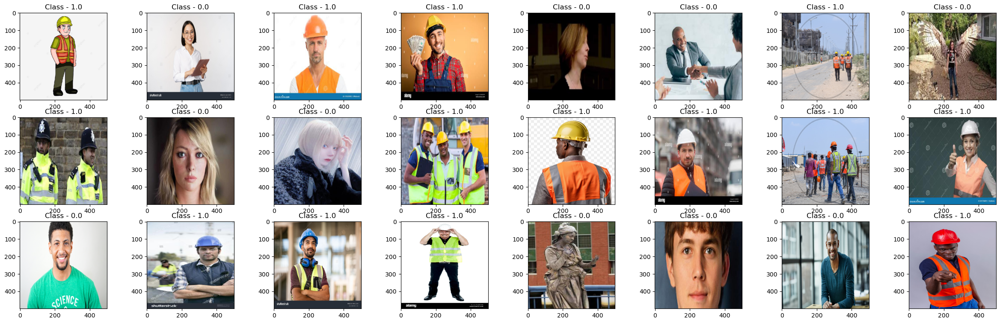

In [254]:
# show each of image from both categories
fig, ax = plt.subplots(nrows=3, ncols=8, figsize=(30,9))
n = 0

for i in range(3):
  for j in range(8):
    img = data[0][0][n].astype("uint8")
    ax[i][j].imshow(img)
    ax[i][j].set_title("Class - " + str(data[0][1][n]))
    n += 1

## 3.4. Data Loading Conclusion

Dataset adalah gambar sebanyak 355 gambar dan gambar-gambar tersebut terkelompokan menjadi 2 kategori, yaitu:
- Gambar menggunakan safety gear (161 gambar), diberi label sebagai class 1

- Gambar tidak menggunakan safety gear (194 gambar), diberi label sebagai class 0

# 4. Exploratory Data Analysis (EDA)

## 4.1. Color

In [382]:
# init dominant_colors
dominant_colors_wear = []
dominant_colors_notwear = []
random_state = 13
k = 4

# loop
for path, label in zip(df_img["images"], df_img["label"]):
    # read image with OpenCV
    images = cv2.imread(path)
    if images is None:
        continue
    images = cv2.cvtColor(images, cv2.COLOR_BGR2RGB)
    
    # reshape image
    pixels = images.reshape(-1, 3)
    
    # kmeans
    kmeans = KMeans(n_clusters=k, random_state=random_state)
    kmeans.fit(pixels)
    
    # dominant color
    dominant_colors = kmeans.cluster_centers_.astype(int)
    
    if label == "wear":
        dominant_colors_wear.extend(dominant_colors)
    else:
        dominant_colors_notwear.extend(dominant_colors)


In [383]:
# convert RGB to hexadecimal
hex_colors_wear = []
for color in dominant_colors_wear[:10]:
    hex_color = mcolors.to_hex([val/255 for val in color])
    hex_colors_wear.append(hex_color)

hex_colors_notwear = []
for color in dominant_colors_notwear[:10]:
    hex_color = mcolors.to_hex([val/255 for val in color])
    hex_colors_notwear.append(hex_color)

# brightness
brightness_wear = []
for color in dominant_colors_wear[:10]:
    bright = np.mean(color)
    brightness_wear.append(bright)

brightness_notwear = []
for color in dominant_colors_notwear[:10]:
    bright = np.mean(color)
    brightness_notwear.append(bright)

# sorting color
sorted_indices_wear = np.argsort(brightness_wear)
sorted_indices_notwear = np.argsort(brightness_notwear)

sorted_colors_wear = [dominant_colors_wear[i] for i in sorted_indices_wear]
sorted_colors_notwear = [dominant_colors_notwear[i] for i in sorted_indices_notwear]

sorted_hex_colors_wear = [hex_colors_wear[i] for i in sorted_indices_wear]
sorted_hex_colors_notwear = [hex_colors_notwear[i] for i in sorted_indices_notwear]

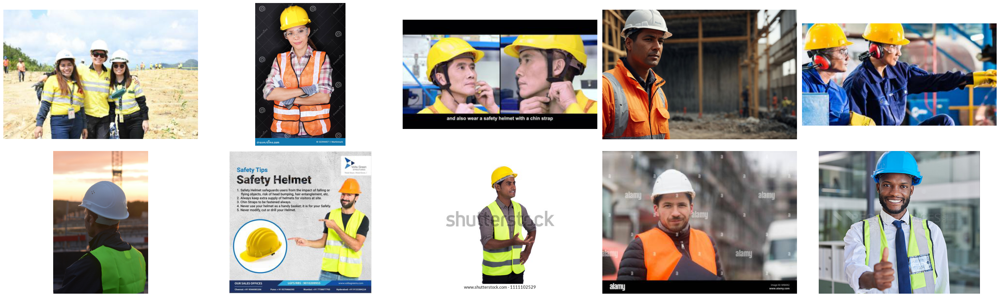

In [257]:
# show wear safety gear images
num_cols = 5
num_rows = 2
num_wear_sg_img = len(wear_sg)

fig, ax = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(30, 9))

for i in range(num_rows):
    for j in range(num_cols):
        img_idx = i * num_cols + j
        if img_idx < num_wear_sg_img:
            wsg = plt.imread(wear_sg[img_idx])
            ax[i, j].imshow(wsg)
            ax[i, j].axis("off")
        else:
            ax[i, j].axis("off")

plt.tight_layout()
plt.show()


insight:
- dari sample yang ditampilkan, secara pengelihatan manusia kelas "Wear Safety Gear" terdapat warna cerah atau dominan dengan warna cerah seperti kuning dan oranye.

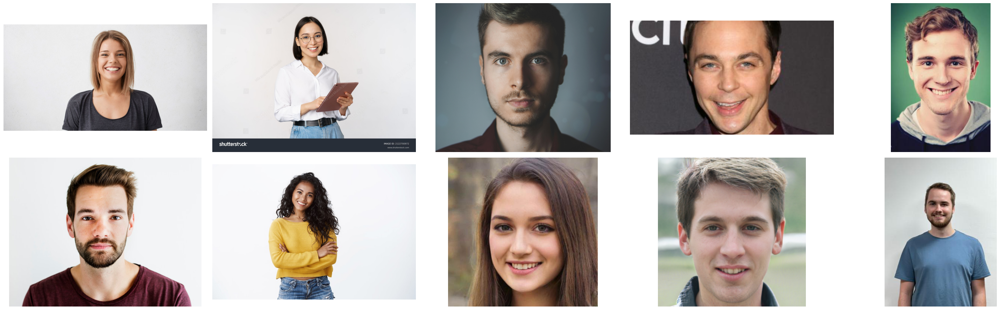

In [258]:
# show not wear safety gear images
num_cols = 5
num_rows = 2
num_notwear_sg_img = len(notwear_sg)

fig, ax = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(30, 9))

for i in range(num_rows):
    for j in range(num_cols):
        img_idx = i * num_cols + j
        if img_idx < num_notwear_sg_img:
            wsg = plt.imread(notwear_sg[img_idx])
            ax[i, j].imshow(wsg)
            ax[i, j].axis("off")
        else:
            ax[i, j].axis("off")

plt.tight_layout()
plt.show()


insight:
- dari sample yang ditampilkan, secara pengelihatan manusia kelas "Not Wear Safety Gear" terlihat lebih netral.

Dominant Color Code (Hex) for Wear Safety Gear class:
['#242421', '#4f423c', '#8a4c21', '#5b6a6b', '#afc4e6', '#e29855', '#eb813b', '#fbbc1e', '#fbfcfb', '#fefdfc']


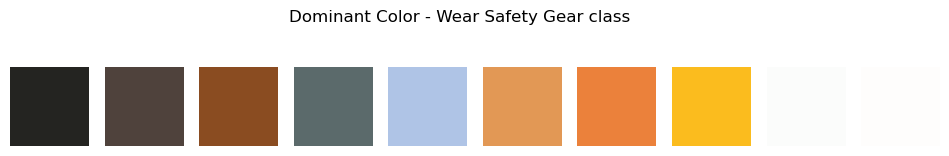


Dominant Color Code (Hex) for Not Wear Safety Gear class:
['#0e0c0c', '#473b33', '#3d4342', '#6e6763', '#7c7469', '#7b7c74', '#bbaa91', '#d0b4a7', '#eee5db', '#f2f3f4']


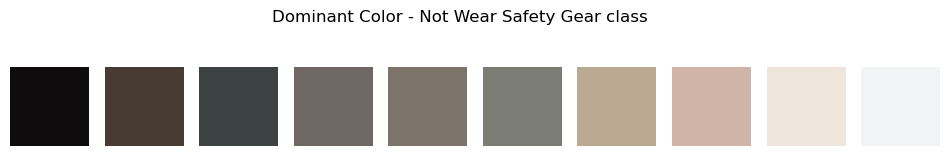

In [419]:
# wear Safety Gear class
print("Dominant Color Code (Hex) for Wear Safety Gear class:")
print(sorted_hex_colors_wear)

# plot dominant color wear Safety Gear class
plt.figure(figsize=(12, 2))
for i, color in enumerate(sorted_colors_wear):
    plt.subplot(1, 10, i+1)
    plt.imshow([[color]])
    plt.axis("off")
plt.suptitle("Dominant Color - Wear Safety Gear class")
plt.show()

# notwear class
print("Dominant Color Code (Hex) for Not Wear Safety Gear class:")
print(sorted_hex_colors_notwear)

# plot dominant color notwear class
plt.figure(figsize=(12, 2))
for i, color in enumerate(sorted_colors_notwear):
    plt.subplot(1, 10, i+1)
    plt.imshow([[color]])
    plt.axis("off")
plt.suptitle("Dominant Color - Not Wear Safety Gear class")
plt.show()

insight:
- Wear Safety Gear cenderung memiliki palet warna yang lebih netral dan cerah, seperti warna abu-abu, cokelat muda dan oranye. Warna-warna ini mungkin menunjukkan adanya pakaian atau perlengkapan keselamatan yang mungkin terbuat dari bahan reflektif atau cerah yang dirancang untuk meningkatkan visibilitas di lingkungan kerja.

- Not Wear Safety Gear memiliki palet warna yang lebih gelap dan lebih kaya, seperti cokelat tua, hijau zaitun dan merah bata. Warna-warna ini mungkin menunjukkan pakaian biasa atau pakaian yang tidak dirancang untuk keamanan yang cenderung lebih redup dan tidak terlalu mencolok.

## 4.2. Size

In [349]:
# init
heights = []
widths = []

# loop height and width
for img_path in df_img["images"]:
    with Image.open(img_path) as img:
        width, height = img.size
        widths.append(width)
        heights.append(height)

# add height and width
df_img["height"] = heights
df_img["width"] = widths
df_img


,images,label,height,width
0,GearedorNot/Wearing Safety Gear/wearsg_002.jpeg,wear,1690,1067
1,GearedorNot/Wearing Safety Gear/wearsg_086.jpg,wear,400,266
2,GearedorNot/Not Wearing Safety Gear/notwearsg_...,notwear,417,626
3,GearedorNot/Not Wearing Safety Gear/notwearsg_...,notwear,400,371
4,GearedorNot/Wearing Safety Gear/wearsg_036.jpeg,wear,956,1300
...,...,...,...,...
350,GearedorNot/Not Wearing Safety Gear/notwearsg_...,notwear,400,273
351,GearedorNot/Wearing Safety Gear/wearsg_135.jpeg,wear,756,1500
352,GearedorNot/Wearing Safety Gear/wearsg_017.jpeg,wear,1100,1500
353,GearedorNot/Wearing Safety Gear/wearsg_069.jpeg,wear,1390,987


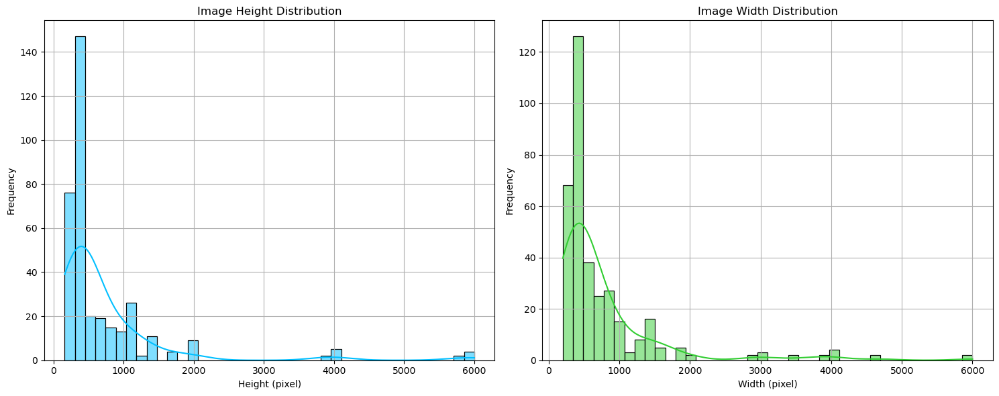

In [156]:
# plot height and width
plt.figure(figsize=(15, 6))

plt.subplot(1, 2, 1)
sns.histplot(df_img["height"], kde=True, bins=40, color="deepskyblue")
plt.title("Image Height Distribution")
plt.xlabel("Height (pixel)")
plt.ylabel("Frequency")
plt.grid(True)

plt.subplot(1, 2, 2)
sns.histplot(df_img["width"], kde=True, bins=40, color="limegreen")
plt.title("Image Width Distribution")
plt.xlabel("Width (pixel)")
plt.ylabel("Frequency")

plt.tight_layout()
plt.grid(True)
plt.show()

insight:
- Sebagian besar gambar dalam dataset memiliki tinggi yang relatif kecil, berkisar antara 250 hingga 500 pixel. Ini mungkin menunjukkan bahwa sebagian besar gambar dalam dataset adalah gambar kecil atau diperkecil.

- Ada beberapa gambar dengan tinggi yang jauh lebih besar, mencapai lebih dari 4000 pixel meskipu jumlahnya sangat sedikit.

- Mirip dengan distribusi tinggi gambar, distribusi lebar gambar menunjukkan bahwa sebagian besar gambar dalam dataset memiliki lebar yang relatif kecil, berkisar antara 250 hingga 500 pixel.

- Ada juga beberapa gambar dengan lebar yang jauh lebih besar bahkan mencapai lebih dari 4000 pixel.

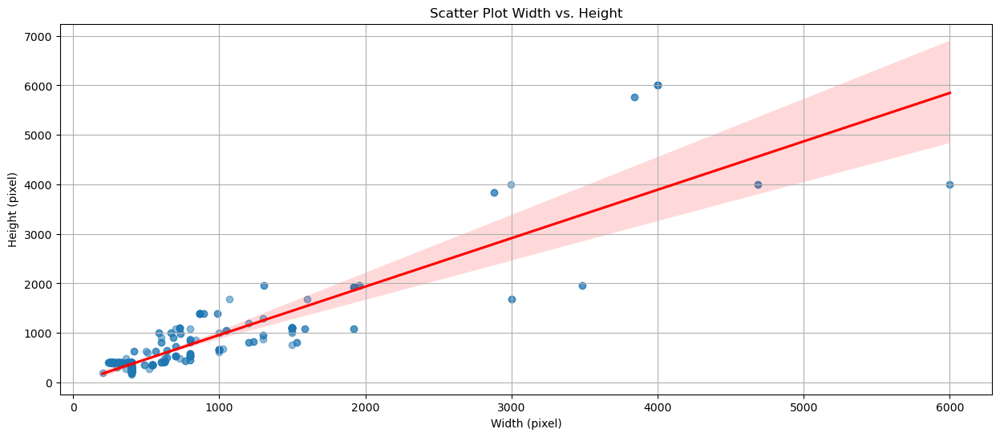

In [21]:
# scatter plot
plt.figure(figsize=(15, 6))
sns.regplot(x="width", y="height", data=df_img, scatter_kws={"alpha":0.5}, line_kws={"color":"red"})
plt.title("Scatter Plot Width vs. Height")
plt.xlabel("Width (pixel)")
plt.ylabel("Height (pixel)")
plt.grid(True)
plt.show()

insight:
- Scatter plot menunjukkan adanya korelasi positif yang kuat antara lebar dan tinggi gambar. Artinya, semakin besar lebar gambar, semakin besar pula tingginya. Ini mencerminkan bahwa proporsi antara lebar dan tinggi gambar cenderung konsisten di seluruh dataset.

- Banyak gambar tampak berada dalam rentang ukuran yang serupa dengan sebagian besar gambar memiliki lebar dan tinggi yang berkisar antara 0 hingga 2000 pixel. Namun, ada beberapa gambar yang memiliki ukuran lebih besar, dengan lebar dan tinggi yang mencapai lebih dari 4000 pixel

Average image size per class:
             height       width
label                          
notwear  664.247423  732.139175
wear     806.385093  807.826087


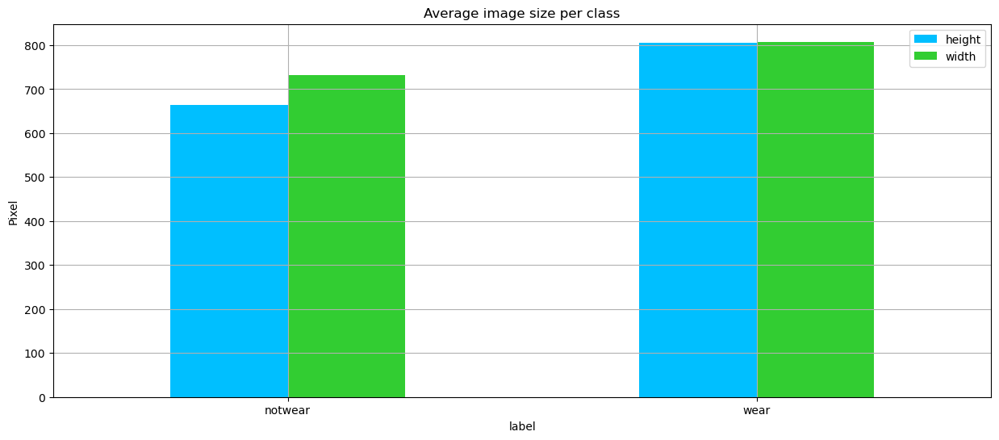

In [22]:
# group by label
grouped = df_img.groupby("label").agg({
    "height": "mean",
    "width": "mean"
})

print("Average image size per class:")
print(grouped)

# plot
grouped.plot(kind="bar", figsize=(15, 6), color=["deepskyblue", "limegreen"])
plt.title("Average image size per class")
plt.ylabel("Pixel")
plt.xticks(rotation=0)
plt.grid(True)
plt.show()

insight:
- Ukuran rata-rata gambar, baik dari segi tinggi (height) maupun lebar (width), terlihat hampir sama antara dua kelas, yaitu "wear" dan "notwear". Ini menunjukkan bahwa tidak ada perbedaan signifikan dalam dimensi gambar antara kedua kategori ini. Artinya, aspek ukuran gambar tidak menjadi faktor pembeda antara gambar yang dikategorikan sebagai "wear" dan "notwear".

- Ukuran rata-rata tinggi dan lebar gambar dalam kelas yang sama juga konsisten. Ini menunjukkan bahwa gambar dalam setiap kategori memiliki proporsi yang serupa, baik dalam hal tinggi maupun lebar, yang mungkin mencerminkan konsistensi dalam proses pengambilan gambar.

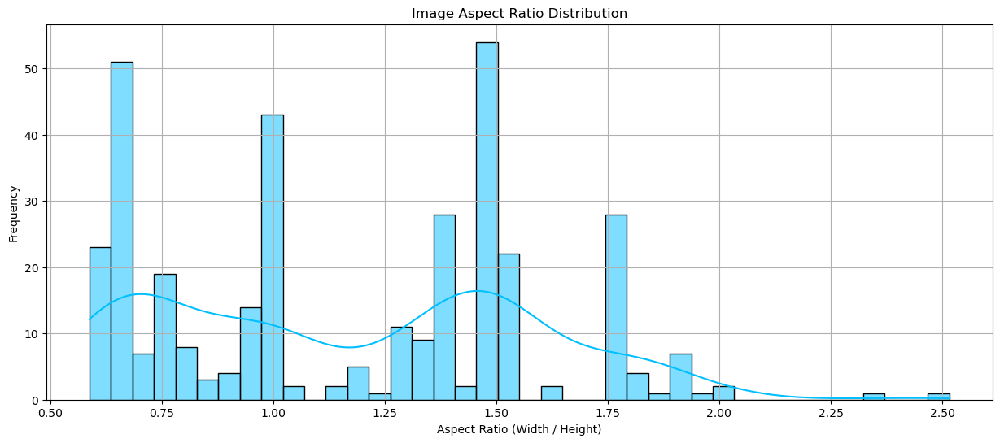

In [157]:
# aspect ratio
df_img["aspect_ratio"] = df_img["width"] / df_img["height"]

# plot aspect ratio
plt.figure(figsize=(15, 6))
sns.histplot(df_img["aspect_ratio"], kde=True, bins=40, color="deepskyblue")
plt.title("Image Aspect Ratio Distribution")
plt.xlabel("Aspect Ratio (Width / Height)")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()

insight:
- Ada dua kelompok utama pada distribusi rasio aspek, yang menunjukkan bahwa gambar cenderung berada dalam dua bentuk utama: Landscape (rasio aspek > 1) dan Portrait (rasio aspek < 1).

- Hal ini mungkin mencerminkan variasi alami dalam orientasi gambar di dalam dataset, atau bisa juga disebabkan oleh sumber gambar yang berbeda (misalnya, kamera yang digunakan atau cara pengambilan gambar).

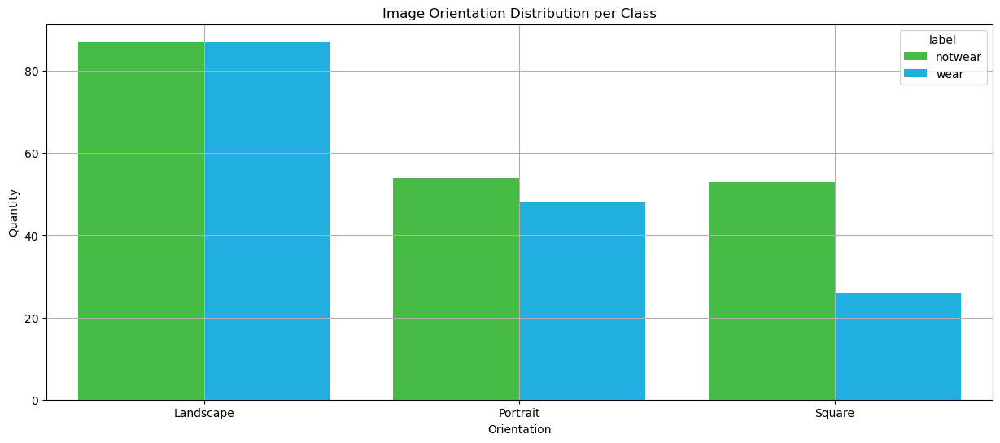

In [158]:
# image orientation
def determ_orientation(aspect_ratio):
    if aspect_ratio > 1.2:
        return "Landscape"
    elif aspect_ratio < 0.8:
        return "Portrait"
    else:
        return "Square"

df_img["orientation"] = df_img["aspect_ratio"].apply(determ_orientation)

# plot
plt.figure(figsize=(15, 6))
sns.countplot(x="orientation", hue="label", data=df_img, palette={"wear": "deepskyblue", "notwear": "limegreen"})
plt.title("Image Orientation Distribution per Class")
plt.xlabel("Orientation")
plt.ylabel("Quantity")
plt.grid(True)
plt.show()


insight:
- Baik untuk kelas "wear" maupun "not wear," gambar dengan orientasi landscape mendominasi jumlah gambar yang ada. Ini menunjukkan bahwa sebagian besar gambar dalam dataset diambil dengan orientasi landscape, yang mungkin mencerminkan preferensi umum dalam pengambilan gambar atau karakteristik lingkungan kerja yang cenderung mendukung orientasi ini.

- Gambar dengan orientasi portrait dan square lebih jarang muncul dibandingkan dengan landscape. Namun, distribusi antara kedua kelas pada orientasi ini terlihat relatif seimbang, terutama untuk orientasi portrait.

- Kelas "wear" memiliki lebih sedikit gambar dengan orientasi square dibandingkan dengan kelas "not wear," yang mungkin menunjukkan bahwa gambar dalam kategori "wear" lebih sering diambil dengan latar belakang yang lebih luas, sementara gambar "not wear" cenderung lebih berfokus pada subjek.

## 4.3. Color Chanel

In [160]:
# init
mean_colors_wear = []
mean_colors_notwear = []

for path, label in zip(df_img["images"], df_img["label"]):
    image = cv2.imread(path)
    if image is None:
        continue
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    # average value for each color channel
    mean_color = image.mean(axis=(0,1))
    
    if label == "wear":
        mean_colors_wear.append(mean_color)
    else:
        mean_colors_notwear.append(mean_color)

# convert to array
mean_colors_wear = np.array(mean_colors_wear)
mean_colors_notwear = np.array(mean_colors_notwear)

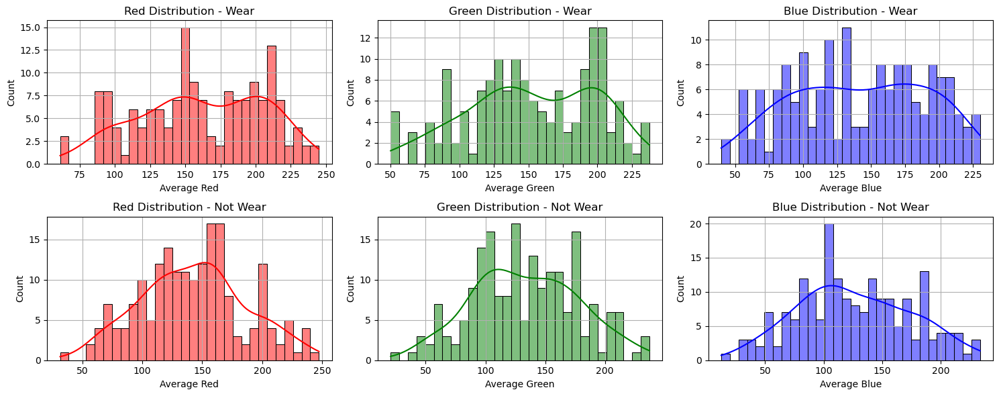

In [161]:
# plot
plt.figure(figsize=(15, 6))

channels = ["Red", "Green", "Blue"]
for i, channel in enumerate(channels):
    plt.subplot(2, 3, i+1)
    sns.histplot(mean_colors_wear[:, i], color=channel.lower(), bins=30, kde=True)
    plt.title(f"{channel} Distribution - Wear")
    plt.xlabel(f"Average {channel}")
    plt.grid(True)
    
    plt.subplot(2, 3, i+4)
    sns.histplot(mean_colors_notwear[:, i], color=channel.lower(), bins=30, kde=True)
    plt.title(f"{channel} Distribution - Not Wear")
    plt.xlabel(f"Average {channel}")
    plt.grid(True)

plt.tight_layout()
plt.show()

insight:

Distribusi Warna Merah:

- Pada kelas "wear" dan "not wear", distribusi warna merah cenderung seragam dengan puncak yang berbeda. Pada kelas "wear", nilai rata-rata warna merah lebih tersebar, sedangkan pada kelas "not wear", terlihat ada puncak distribusi yang lebih jelas di sekitar nilai 150.

- Ini mungkin menunjukkan bahwa gambar dalam kategori "wear" memiliki variasi yang lebih besar dalam intensitas warna merah, sementara gambar dalam kategori "not wear" cenderung memiliki intensitas merah yang lebih terpusat.

Distribusi Warna Hijau:

- Warna hijau pada kelas "wear" juga menunjukkan variasi yang cukup besar dengan beberapa puncak distribusi. Di sisi lain, pada kelas "not wear", distribusi warna hijau juga menunjukkan adanya puncak yang lebih dominan sekitar nilai 125 hingga 150.

- Hal ini bisa menunjukkan bahwa gambar dalam kelas "wear" memiliki lebih banyak variasi dalam intensitas warna hijau dibandingkan dengan kelas "not wear."

Distribusi Warna Biru:

- Pada kelas "wear", distribusi warna biru lebih merata dengan puncak distribusi di sekitar nilai 100 hingga 150. Sedangkan pada kelas "not wear", puncak distribusi warna biru lebih terlihat dengan nilai yang lebih rendah sekitar 100.

- Sebaliknya, distribusi warna biru pada kelas "not wear" lebih terfokus di sekitar puncak tertentu, yang berarti warna biru dalam gambar-gambar ini cenderung lebih konsisten.


## 4.4. Angle

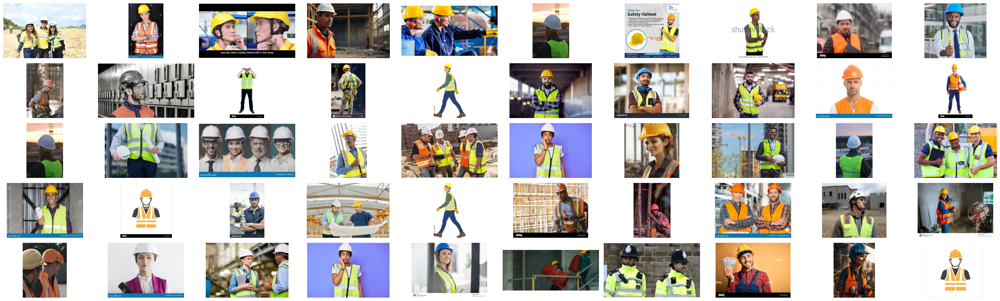

In [423]:
# show wear safety gear images
num_cols = 10
num_rows = 5
num_wear_sg_img = len(wear_sg)

fig, ax = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(30, 9))

for i in range(num_rows):
    for j in range(num_cols):
        img_idx = i * num_cols + j
        if img_idx < num_wear_sg_img:
            wsg = plt.imread(wear_sg[img_idx])
            ax[i, j].imshow(wsg)
            ax[i, j].axis("off")
        else:
            ax[i, j].axis("off")

plt.tight_layout()
plt.show()

insight:
- dilihat dari sample yang ditampilkan sudut gambar untuk "Wear Safety Gear" relatif lebih banyak gambar yang diambil dari sudut depan atau sedikit menyamping.

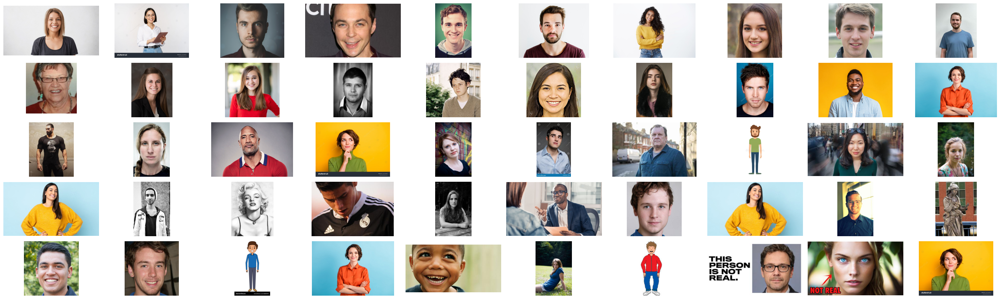

In [424]:
# show not wear safety gear images
num_notwear_sg_images = len(notwear_sg)

fig, ax = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(30, 9))

for i in range(num_rows):
    for j in range(num_cols):
        img_idx = i * num_cols + j
        if img_idx < num_notwear_sg_images:
            wsg = plt.imread(notwear_sg[img_idx])
            ax[i, j].imshow(wsg)
            ax[i, j].axis("off")
        else:
            ax[i, j].axis("off")

plt.tight_layout()
plt.show()

insight:
- dilihat dari sample yang ditampilkan sudut gambar untuk "Not Wear Safety Gear" juga relatif lebih banyak gambar yang diambil dari sudut depan atau sedikit menyamping.

In [145]:
# init angle
angles_wear = []
angles_notwear = []

# loop dominant angle
for path, label in zip(df_img["images"], df_img["label"]):
    image = cv2.imread(path)
    if image is None:
        continue
    
    # convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    #  x and y gradient
    grad_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
    
    # gradient angle
    angles = np.arctan2(grad_y, grad_x)
    
    # to degrees
    angles_degrees = np.degrees(angles)
    
    # hist angle
    hist, bins = np.histogram(angles_degrees, bins=np.arange(-180, 181, 1))
    
    # dominant angle
    dominant_angle = bins[np.argmax(hist)]
    
    # append
    if label == "wear":
        angles_wear.append(dominant_angle)
    else:
        angles_notwear.append(dominant_angle)

# DataFrame
df_angles = pd.DataFrame({
    "Angle": angles_wear + angles_notwear,
    "Label": ["wear"] * len(angles_wear) + ["notwear"] * len(angles_notwear)
})

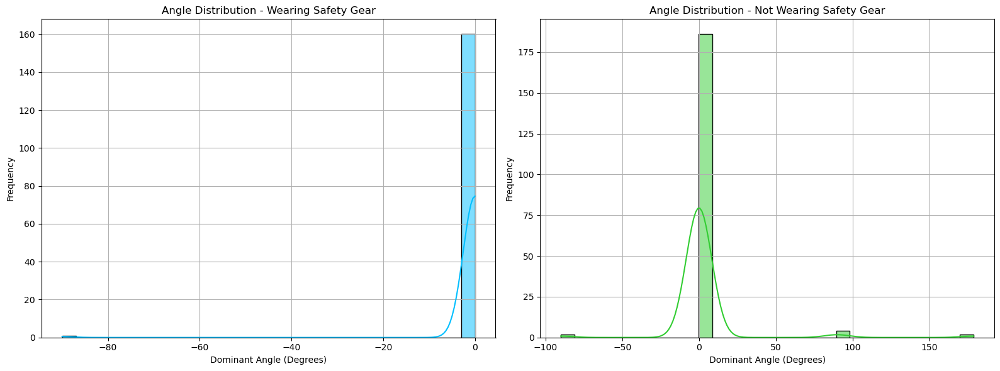

In [159]:
# figure
plt.figure(figsize=(16, 6))

# plot wear
plt.subplot(1, 2, 1)
sns.histplot(data=df_angles[df_angles["Label"] == "wear"], x="Angle", kde=True, bins=30, color="deepskyblue")
plt.title("Angle Distribution - Wearing Safety Gear")
plt.xlabel("Dominant Angle (Degrees)")
plt.ylabel("Frequency")
plt.grid(True)

# plot not wear
plt.subplot(1, 2, 2)
sns.histplot(data=df_angles[df_angles["Label"] == "notwear"], x="Angle", kde=True, bins=30, color="limegreen")
plt.title("Angle Distribution - Not Wearing Safety Gear")
plt.xlabel("Dominant Angle (Degrees)")
plt.ylabel("Frequency")
plt.grid(True)

# show plot
plt.tight_layout()
plt.show()

insight:
- Baik untuk kategori "wear" maupun "not wear", distribusi sudut gambar menunjukkan bahwa mayoritas gambar berada di sudut sekitar 0 derajat. Ini menunjukkan bahwa gambar-gambar ini sebagian besar diambil dengan sudut yang konsisten, tanpa banyak rotasi atau kemiringan.

- Gambar-gambar dengan sudut 0 derajat menunjukkan bahwa kamera kemungkinan besar dipegang secara horizontal saat mengambil gambar.

- Ada beberapa outlier dengan sudut yang lebih besar atau lebih kecil dari 0 derajat, terutama untuk kategori "not wear" namun jumlahnya sangat sedikit jika dibandingkan dengan gambar-gambar yang memiliki sudut 0 derajat.

- Ini mungkin menunjukkan bahwa ada beberapa gambar yang diambil dengan sudut yang tidak biasa, mungkin karena posisi kamera atau kondisi lingkungan saat pengambilan gambar.

## 4.5. Brightness, Sharpness and Edge Density

In [163]:
# init
brightness_list = []
sharpness_list = []
edge_density_list = []

for img_path in df_img["images"]:
    img = Image.open(img_path)
    img_np = np.array(img)
    
    # brightness
    enhancer = ImageEnhance.Brightness(img)
    brightness = np.mean(np.array(enhancer.enhance(1))) / 255.0
    brightness_list.append(brightness)
    
    # sharpness
    enhancer = ImageEnhance.Sharpness(img)
    sharpness = np.mean(np.array(enhancer.enhance(2))) / 255.0
    sharpness_list.append(sharpness)
    
    # edge density
    gray_img = cv2.cvtColor(img_np, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray_img, threshold1=100, threshold2=200)
    edge_density = np.sum(edges) / (img_np.shape[0] * img_np.shape[1])
    edge_density_list.append(edge_density)

# add to df_img
df_img["brightness"] = brightness_list
df_img["sharpness"] = sharpness_list
df_img["edge_density"] = edge_density_list

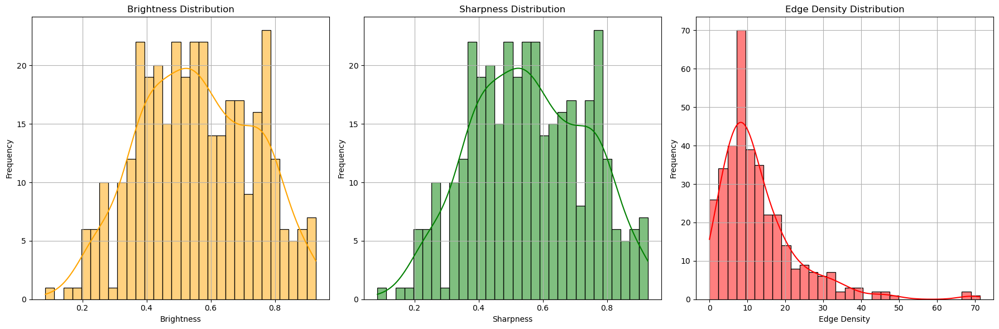

In [165]:
# figure
plt.figure(figsize=(18, 6))

# brightness
plt.subplot(1, 3, 1)
sns.histplot(df_img["brightness"], bins=30, color="orange", kde=True)
plt.title("Brightness Distribution")
plt.xlabel("Brightness")
plt.ylabel("Frequency")
plt.grid(True)

# sharpness
plt.subplot(1, 3, 2)
sns.histplot(df_img["sharpness"], bins=30, color="green", kde=True)
plt.title("Sharpness Distribution")
plt.xlabel("Sharpness")
plt.ylabel("Frequency")
plt.grid(True)

# edge density
plt.subplot(1, 3, 3)
sns.histplot(df_img["edge_density"], bins=30, color="red", kde=True)
plt.title("Edge Density Distribution")
plt.xlabel("Edge Density")
plt.ylabel("Frequency")
plt.grid(True)

plt.tight_layout()
plt.show()


insight:

Brightness.

- Distribusi kecerahan menunjukkan penyebaran yang cukup merata dengan puncak yang berada di sekitar nilai 0.5. Ini menunjukkan bahwa mayoritas gambar memiliki tingkat kecerahan yang sedang. Tidak ada distribusi yang terlalu dominan di sisi rendah atau tinggi, yang mungkin menunjukkan bahwa pencahayaan dalam gambar relatif seragam dan tidak terlalu terang atau gelap.

Sharpness.

- Distribusi ketajaman juga menunjukkan pola yang serupa dengan kecerahan, dengan puncak di sekitar nilai 0.5. Hal ini menunjukkan bahwa sebagian besar gambar memiliki ketajaman yang sedang, yang berarti gambar tidak terlalu kabur atau terlalu tajam. Ini mungkin mengindikasikan bahwa gambar diambil dalam kondisi pencahayaan yang baik dan fokus yang cukup.

Edge Density.

- Distribusi kepadatan tepi menunjukkan puncak yang sangat tinggi pada nilai yang rendah (sekitar 10), yang menunjukkan bahwa mayoritas gambar memiliki sedikit tepi yang terdeteksi. Ini bisa menunjukkan bahwa gambar mungkin memiliki latar belakang yang lebih halus atau objek utama dalam gambar yang lebih sederhana tanpa banyak detail kecil.

## 4.6. EDA Conclusion

Hasil eksplorasi menunjukkan bahwa fitur visual seperti warna, ukuran dan atribut lain seperti kecerahan dan ketajaman dapat memberikan informasi penting dalam membedakan antara gambar "wearing safety gear" dan "not wearing safety gear" walaupun beberapa fitur tidak menunjukkan perbedaan yang mencolok antara kedua kategori, kombinasi dari beberapa fitur ini dapat digunakan dalam model pembelajaran mesin untuk klasifikasi gambar secara lebih efektif.

# 5. Feature Engineering

## 5.1. Preprocessing

In [402]:
# init
path = "GearedorNot/"
rescale = 1./255
validation_split = 0.2
batch_size = 256
seed = 2

# ImageDataGenerator training set with data augmentation
train = ImageDataGenerator(
    rescale=rescale,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode="nearest",
    validation_split=validation_split
)

# ImageDataGenerator validasi set
val = ImageDataGenerator(
    rescale=rescale,
    validation_split=validation_split
)

insight:
- Pada train set terdapat 285 gambar yang terbagi menjadi 2 class. Pada validation set terdapat 70 yang terbagi menjadi 2 class.

- Normalisasi pixel gambar ke rentang [0, 1] membantu dalam stabilisasi pelatihan model. Tanpa normalisasi, nilai pixel yang besar dapat menyebabkan gradien yang terlalu besar, yang bisa memperlambat atau bahkan menghentikan konvergensi model.

- Rotasi gambar hingga 40 derajat membantu model menjadi lebih robust terhadap orientasi objek yang berbeda. Misalnya, gambar yang diambil dari berbagai sudut dapat memiliki orientasi yang berbeda dan rotasi membantu model untuk mengenali objek yang sama meskipun posisinya berbeda.

- Pergeseran horizontal dan vertikal gambar hingga 20% membantu model untuk mengenali objek meskipun tidak berada tepat di tengah gambar. Ini membuat model lebih fleksibel dalam mendeteksi objek yang mungkin muncul pada posisi yang berbeda dalam gambar.

- Transformasi geser (shear) hingga 20% mengubah sudut pandang gambar, yang membantu model untuk mengenali objek meskipun mereka tampak miring atau distorsi perspektif.

- Zoom hingga 20% membantu model untuk mengenali objek dengan ukuran yang berbeda. Ini memungkinkan model untuk menangani gambar di mana objek utama dapat muncul lebih besar atau lebih kecil dibandingkan dengan ukuran aslinya dalam dataset.

- Membalik gambar secara horizontal berguna untuk memperluas dataset dengan gambar-gambar yang berorientasi cermin.

- Fill mode memastikan bahwa piksel yang kosong setelah transformasi diisi dengan piksel terdekat. Ini membantu menjaga keutuhan gambar dan menghindari artefak yang dapat membingungkan model.

In [403]:
# init var
target_size = (224, 224)
class_mode = "binary"

# load train set
train_generator = train.flow_from_directory(
    path,
    target_size=target_size,
    class_mode=class_mode,
    subset="training",
    shuffle=False,
    seed=2,
    batch_size=batch_size
)

# load val set
val_generator = val.flow_from_directory(
    path,
    target_size=target_size,
    class_mode=class_mode,
    subset="validation",
    shuffle=False,
    seed=2,
    batch_size=batch_size
)

Found 285 images belonging to 2 classes.
Found 70 images belonging to 2 classes.


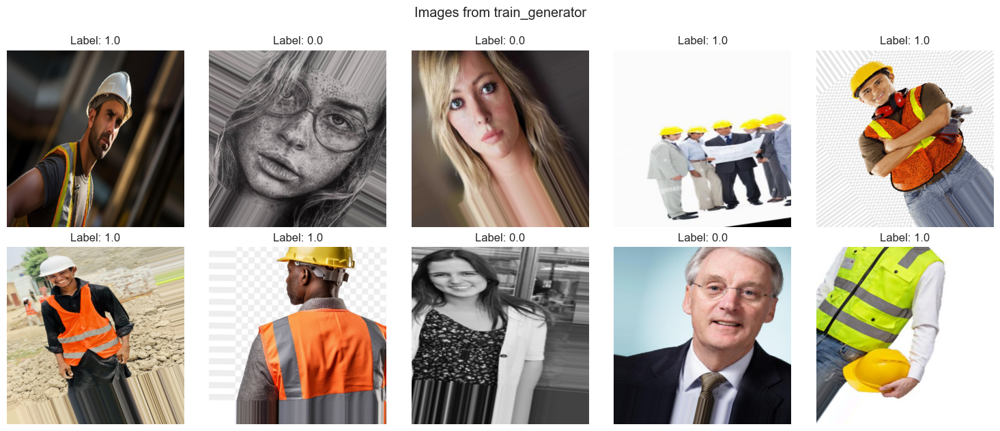

In [82]:
# get image from train_generator
train_batch = next(train_generator)
train_images, train_labels = train_batch

# figure
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(15, 6))
n = 0

# loop image
for i in range(2):
    for j in range(5):
        if n < len(train_images):
            img = train_images[n] * 255.0
            img = img.astype(np.uint8)
            ax[i][j].imshow(img)
            ax[i][j].set_title(f"Label: {train_labels[n]}")
            ax[i][j].axis("off")
            n += 1
        else:
            ax[i][j].axis("off")

plt.tight_layout()
plt.suptitle("Images from train_generator", y=1.05)
plt.show()


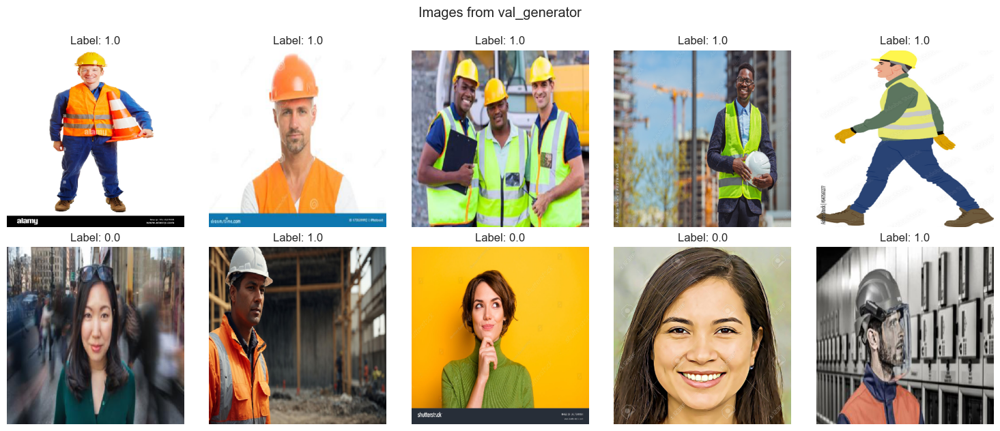

In [83]:
# get image from val_generator
val_batch = next(val_generator)
val_images, val_labels = val_batch

# figure
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(15, 6))
n = 0

# loop image
for i in range(2):
    for j in range(5):
        if n < len(val_images):
            img = val_images[n] * 255.0
            img = img.astype(np.uint8)
            ax[i][j].imshow(img)
            ax[i][j].set_title(f"Label: {val_labels[n]}")
            ax[i][j].axis("off")
            n += 1
        else:
            ax[i][j].axis("off")

plt.tight_layout()
plt.suptitle("Images from val_generator", y=1.05)
plt.show()


# 6. CNN Training

## 6.1. Model Definition

In [328]:
# init
model = Sequential()

model.add(Conv2D(32, (3, 3), activation="relu", input_shape=(target_size[0], target_size[1], 3)))
# model.add(Input(shape=(target_size[0], target_size[1], 3)))
model.add(MaxPooling2D((2, 2)))

model.add(Conv2D(64, (3, 3), activation="relu"))
model.add(MaxPooling2D((2, 2)))

model.add(Conv2D(128, (3, 3), activation="relu"))
model.add(MaxPooling2D((2, 2)))

model.add(Conv2D(128, (3, 3), activation="relu"))
model.add(MaxPooling2D((2, 2)))

model.add(Flatten())

model.add(Dense(256, activation="relu"))
model.add(Dropout(0.5))
model.add(Dense(1, activation="sigmoid"))

In [329]:
# compile model
model.compile(
    loss = "binary_crossentropy",
    optimizer="Adam",
    metrics=["accuracy"]
)

In [330]:
# model summary
model.summary()

Model: "sequential_18"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_82 (Conv2D)              │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_82 (MaxPooling2D) │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_83 (Conv2D)              │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_83 (MaxPooling2D) │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_84 (Conv2D)              │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_84 (MaxPooling2D) │ (None, 26, 26, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_85 (Conv2D)              │ (None, 24, 24, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_85 (MaxPooling2D) │ (None, 12, 12, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_18 (Flatten)            │ (None, 18432)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 256)            │     4,718,848 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_27 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,959,937 (18.92 MB)

 Trainable params: 4,959,937 (18.92 MB)

 Non-trainable params: 0 (0.00 B)

Model ini merupakan sebuah Convolutional Neural Network (CNN) sederhana yang dirancang untuk klasifikasi biner, yaitu mendeteksi apakah seseorang memakai perlengkapan keselamatan (safety gear) atau tidak. Model ini terdiri dari beberapa lapisan konvolusi yang diikuti oleh lapisan pooling. Lapisan konvolusi menggunakan kernel 3x3 dengan jumlah filter yang bertambah dari 32 hingga 128, dengan lapisan pooling 2x2 digunakan untuk mengurangi dimensi data secara efisien.

Setelah lapisan konvolusi dan pooling, data diratakan menjadi vektor satu dimensi melalui lapisan Flatten, lalu diteruskan ke lapisan Dense dengan 256 neuron dan aktivasi ReLU. Dropout dengan rate 0.5 digunakan untuk mencegah overfitting dengan menonaktifkan setengah dari neuron secara acak selama pelatihan. Pada akhirnya, lapisan Dense dengan satu neuron dan aktivasi sigmoid digunakan untuk menghasilkan prediksi probabilitas.

Model ini dikompilasi menggunakan binary_crossentropy sebagai fungsi loss dan Adam sebagai optimizer. Pelatihan dilakukan selama 60 epoch, dengan tujuan agar model mampu menangkap fitur penting dari gambar dan melakukan prediksi yang akurat.

## 6.2. Model Training

In [331]:
# count steps per epoch based on the number of images and batch size
steps_per_epoch = len(train_generator) // train_generator.batch_size
validation_steps = len(val_generator) // val_generator.batch_size

In [332]:
# train model (runtime about 10 mins)
history = model.fit(
    train_generator,
    epochs=60,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_generator,
    validation_steps=validation_steps,
    verbose=1
)


Epoch 1/60
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 399ms/step - accuracy: 0.4860 - loss: 0.6911WARNING:tensorflow:5 out of the last 43 calls to <function TensorFlowTrainer.make_test_function.<locals>.one_step_on_iterator at 0x31f861760> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.
2/2 ━━━━━━━━━━━━━━━━━━━━ 11s 2s/step - accuracy: 0.4866 - loss: 0.6914 - val_accuracy: 0.5429 - val_loss: 1.8527
Epoch 2/60
2/2 ━━━━━━━━━━━━━━━━━━━━ 9s 5s/step - accuracy: 0.5488 - loss: 1.1262 - val_accuracy

## 6.3. Model Evaluation

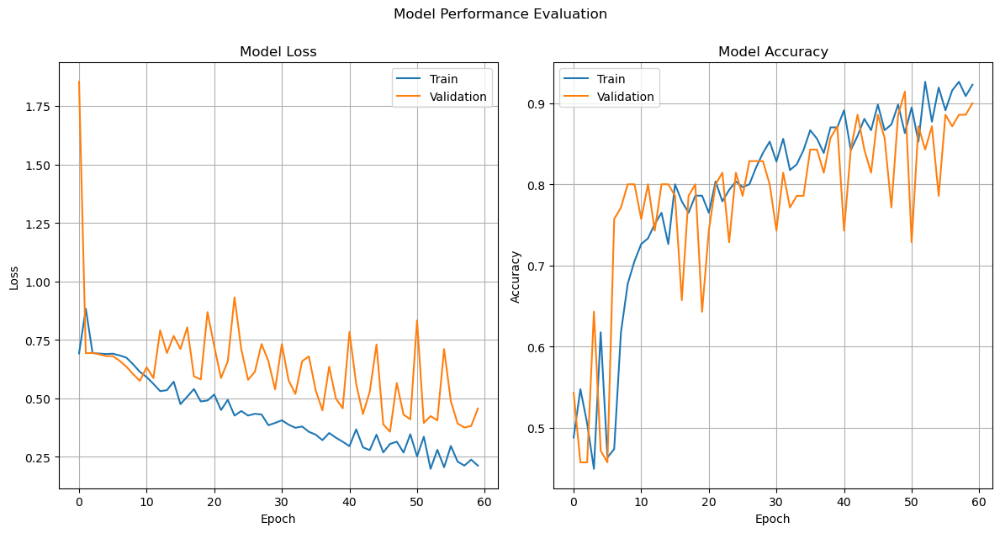

In [333]:
# figure
plt.figure(figsize=(12, 6))

# loss plot
plt.subplot(1, 2, 1)
sns.lineplot(data=history.history, x=range(len(history.history["loss"])), y="loss", label="Train")
sns.lineplot(data=history.history, x=range(len(history.history["val_loss"])), y="val_loss", label="Validation")
plt.title("Model Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend(loc="upper right")
plt.grid(True)

# accuracy plot
plt.subplot(1, 2, 2)
sns.lineplot(data=history.history, x=range(len(history.history["accuracy"])), y="accuracy", label="Train")
sns.lineplot(data=history.history, x=range(len(history.history["val_accuracy"])), y="val_accuracy", label="Validation")
plt.title("Model Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend(loc="upper left")
plt.grid(True)

plt.tight_layout()
plt.suptitle("Model Performance Evaluation", y=1.05)
plt.show()


insight:
- Pada awal pelatihan, baik loss untuk training maupun validation set mulai menurun dengan cukup cepat. Namun, setelah beberapa epoch, terlihat bahwa loss pada validation set cenderung berfluktuasi dengan cukup besar. Meskipun loss pada training set terus menurun, validation loss tidak menurun secara konsisten, dan malah menunjukkan fluktuasi yang cukup besar di beberapa titik.

- Akurasi pada training set meningkat secara stabil dan mencapai nilai yang cukup tinggi, mendekati atau melebihi 80%. Namun, akurasi pada validation set menunjukkan pola fluktuatif, dengan akurasi yang sering naik dan turun secara signifikan dari satu epoch ke epoch berikutnya.

- Ada indikasi potensi overfitting karena model menunjukkan penurunan loss yang stabil dan peningkatan akurasi pada training set, sementara validation set menunjukkan fluktuasi yang lebih besar. Ini bisa menandakan bahwa model belajar terlalu baik pada data training tetapi gagal untuk menggeneralisasi dengan baik pada data yang tidak terlihat, yang terlihat dari fluktuasi pada validation loss dan akurasi.

- Meskipun model berhasil mencapai akurasi yang tinggi pada training set, kinerja pada validation set yang tidak stabil menunjukkan bahwa model mungkin belum mencapai performa optimal untuk data yang belum terlihat. Perlu dilakukan langkah-langkah tambahan untuk memastikan bahwa model dapat menangani data baru dengan lebih baik dan mengurangi fluktuasi pada validation loss dan akurasi.

In [334]:
# check train accuracy
train_loss_model, train_acc_model = model.evaluate(train_generator)
print(f"Train loss: {train_loss_model}%")
print(f"Train accuracy: {train_acc_model * 100:.2f}%")

# check test accuracy
test_loss_model, test_acc_model = model.evaluate(val_generator)
print(f"Test loss: {test_loss_model}%")
print(f"Test accuracy: {test_acc_model * 100:.2f}%")

2/2 ━━━━━━━━━━━━━━━━━━━━ 5s 107ms/step - accuracy: 0.9420 - loss: 0.1934
Train loss: 0.19716006517410278%
Train accuracy: 94.04%
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 677ms/step - accuracy: 0.9000 - loss: 0.4566
Test loss: 0.45661142468452454%
Test accuracy: 90.00%


insight:
- Dari hasil evaluasi model, terlihat bahwa model memiliki akurasi sebesar 94.04% pada training set, yang menunjukkan kemampuan model dalam mengklasifikasikan sebagian besar gambar dengan benar pada data yang telah dilatih. Nilai loss pada training set adalah 0.1972, yang cukup rendah, menandakan bahwa kesalahan prediksi model relatif kecil dan model telah belajar pola dengan baik.

- Pada validation/test set, model mencapai akurasi sebesar 90.00%, sedikit lebih rendah dari akurasi pada training set. Ini menunjukkan bahwa model dapat melakukan generalisasi dengan baik pada data yang tidak terlihat. Namun, nilai loss pada validation/test set adalah 0.4566, yang lebih tinggi dibandingkan dengan training set, menunjukkan bahwa model membuat kesalahan prediksi yang lebih besar pada data ini.

- Perbedaan antara loss pada training set dan validation/test set mengindikasikan adanya potensi overfitting, di mana model mungkin terlalu "terlatih" pada data training dan kurang mampu menangani variasi pada data baru.

Evaluasi menggunakan akurasi dan loss secara bersama-sama memberikan gambaran yang lebih komprehensif tentang performa model.Akurasi menunjukkan proporsi prediksi yang benar dan loss memberikan wawasan tentang seberapa "salah" prediksi model pada keseluruhan dataset.

# 7. CNN Improvement

## 7.1. Improvement

### 7.1.1. Model Definition

In [366]:
# init
model_improved_2 = Sequential()

model_improved_2.add(Conv2D(32, (3, 3), activation="relu", input_shape=(target_size[0], target_size[1], 3)))
model_improved_2.add(MaxPooling2D((2, 2)))

model_improved_2.add(Conv2D(64, (3, 3), activation="relu", kernel_regularizer=l2(0.01)))
model_improved_2.add(MaxPooling2D((2, 2)))

model_improved_2.add(Conv2D(128, (3, 3), activation="relu", kernel_regularizer=l2(0.01)))
model_improved_2.add(MaxPooling2D((2, 2)))

model_improved_2.add(Conv2D(256, (3, 3), activation="relu", kernel_regularizer=l2(0.01)))
model_improved_2.add(MaxPooling2D((2, 2)))

model_improved_2.add(Conv2D(256, (3, 3), activation="relu", kernel_regularizer=l2(0.01)))
model_improved_2.add(MaxPooling2D((2, 2)))

model_improved_2.add(Conv2D(128, (3, 3), activation="relu", kernel_regularizer=l2(0.01)))
model_improved_2.add(MaxPooling2D((2, 2)))

model_improved_2.add(Flatten())

model_improved_2.add(Dense(256, activation="relu", kernel_regularizer=l2(0.01)))
model_improved_2.add(Dropout(0.5))

model_improved_2.add(Dense(1, activation="sigmoid"))

# compile model_improved_2
model_improved_2.compile(
    loss="binary_crossentropy",
    optimizer=Adam(learning_rate=0.0001),
    metrics=["accuracy"]
)

# callback for early stopping, model checkpoint and reduce learning rate
early_stopping = EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True)
model_checkpoint = ModelCheckpoint("deployment/improved_model_2.keras", monitor="val_accuracy", save_best_only=True)
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.2, patience=5, min_lr=0.00001)

# model_improved_2 summary
model_improved_2.summary()

/opt/anaconda3/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_22"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_104 (Conv2D)             │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_104               │ (None, 111, 111, 32)   │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_105 (Conv2D)             │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_105               │ (None, 54, 54, 64)     │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_106 (Conv2D)             │ (None, 52, 52, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_106               │ (None, 26, 26, 128)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_107 (Conv2D)             │ (None, 24, 24, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_107               │ (None, 12, 12, 256)    │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_108 (Conv2D)             │ (None, 10, 10, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_108               │ (None, 5, 5, 256)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_109 (Conv2D)             │ (None, 3, 3, 128)      │       295,040 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_109               │ (None, 1, 1, 128)      │             0 │
│ (MaxPooling2D)                  │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_22 (Flatten)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 256)            │        33,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_32 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 1)              │           257 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,306,817 (4.99 MB)

 Trainable params: 1,306,817 (4.99 MB)

 Non-trainable params: 0 (0.00 B)

Untuk improvement, model diimprovisasi dengan menambahkan lebih banyak lapisan Conv2D dan MaxPooling2D, serta menambah jumlah filter hingga 256 di beberapa lapisan. Penambahan lapisan ini memungkinkan model untuk belajar fitur yang lebih mendalam dan kompleks dari gambar input, sehingga meningkatkan akurasi pada dataset yang lebih sulit. Selain itu, penggunaan regularisasi L2 (kernel_regularizer=l2(0.01)) pada beberapa lapisan bertujuan untuk mengurangi overfitting dengan menambahkan penalti terhadap bobot besar, yang mendorong model untuk tetap sederhana dan mampu melakukan generalisasi yang lebih baik pada data yang tidak terlihat.

Selain itu, model improved menggunakan dropout dengan rate=0.5 pada lapisan dense, yang membantu mencegah overfitting dengan secara acak menonaktifkan neuron selama pelatihan. Learning rate juga dikurangi menjadi 0.0001 dalam optimizer Adam, memungkinkan penyesuaian bobot yang lebih halus dan konvergensi yang lebih stabil pada model yang lebih kompleks. Dengan kombinasi penambahan lapisan, regularisasi, dan dropout ini, model improved diharapkan mampu memberikan performa yang lebih baik dibandingkan base model, terutama dalam situasi yang melibatkan data dengan tingkat kompleksitas dan detail yang tinggi.

### 7.1.2. Model Training

In [367]:
# train model_improved_2 (runtime about 40 mins)
history_improved_2 = model_improved_2.fit(
    train_generator,
    epochs=240,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_generator,
    validation_steps=validation_steps,
    callbacks=[early_stopping, reduce_lr, model_checkpoint],
    verbose=1
)

Epoch 1/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 12s 2s/step - accuracy: 0.4830 - loss: 9.6313 - val_accuracy: 0.4571 - val_loss: 9.5273 - learning_rate: 1.0000e-04
Epoch 2/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 11s 1s/step - accuracy: 0.5363 - loss: 9.5220 - val_accuracy: 0.4714 - val_loss: 9.4214 - learning_rate: 1.0000e-04
Epoch 3/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 12s 7s/step - accuracy: 0.5069 - loss: 9.3899 - val_accuracy: 0.5714 - val_loss: 9.3168 - learning_rate: 1.0000e-04
Epoch 4/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 11s 7s/step - accuracy: 0.5952 - loss: 9.2845 - val_accuracy: 0.5429 - val_loss: 9.2130 - learning_rate: 1.0000e-04
Epoch 5/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 10s 1s/step - accuracy: 0.5516 - loss: 9.2100 - val_accuracy: 0.5429 - val_loss: 9.1100 - learning_rate: 1.0000e-04
Epoch 6/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 10s 6s/step - accuracy: 0.5488 - loss: 9.0797 - val_accuracy: 0.5429 - val_loss: 9.0083 - learning_rate: 1.0000e-04
Epoch 7/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 10s 1s/step - accuracy: 0.5508 - loss: 9.0049

### 7.1.3. Model Evaluation

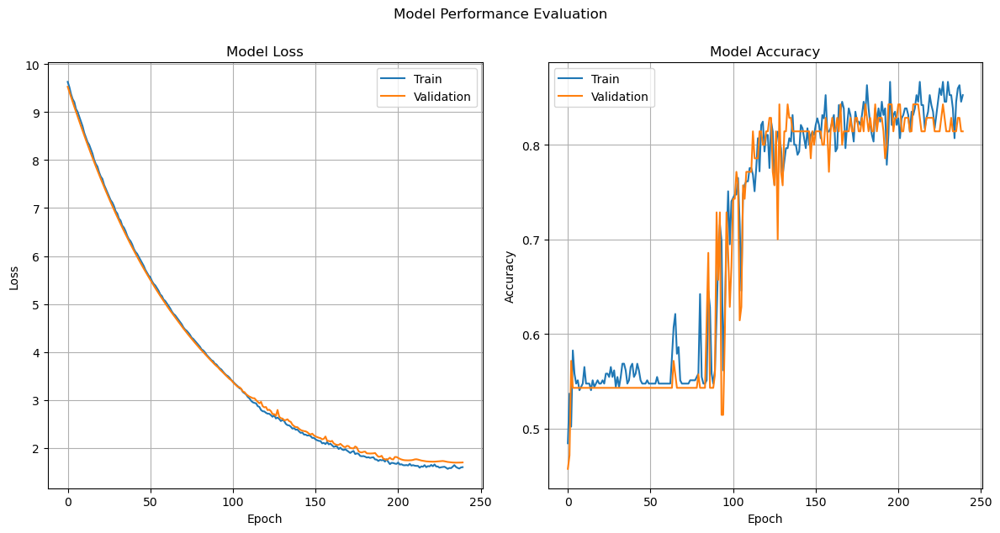

In [368]:
# figure
plt.figure(figsize=(12, 6))

# loss plot
plt.subplot(1, 2, 1)
sns.lineplot(data=history_improved_2.history, x=range(len(history_improved_2.history["loss"])), y="loss", label="Train")
sns.lineplot(data=history_improved_2.history, x=range(len(history_improved_2.history["val_loss"])), y="val_loss", label="Validation")
plt.title("Model Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend(loc="upper right")
plt.grid(True)

# accuracy plot
plt.subplot(1, 2, 2)
sns.lineplot(data=history_improved_2.history, x=range(len(history_improved_2.history["accuracy"])), y="accuracy", label="Train")
sns.lineplot(data=history_improved_2.history, x=range(len(history_improved_2.history["val_accuracy"])), y="val_accuracy", label="Validation")
plt.title("Model Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend(loc="upper left")
plt.grid(True)

plt.tight_layout()
plt.suptitle("Model Performance Evaluation", y=1.05)
plt.show()


insight:

- Loss untuk training dan validation set menurun secara konsisten selama training hingga mendekati nilai rendah di akhir training. Ini menunjukkan bahwa model 2 berhasil mengonvergensi dengan baik, dengan tidak ada fluktuasi besar pada nilai loss.

- Akurasi pada kedua set (training dan validation) juga meningkat secara bertahap, meskipun ada fluktuasi yang lebih besar pada akurasi di awal pelatihan. Namun, setelah sekitar 100 epoch, akurasi pada training dan validation set mulai stabil dan mencapai sekitar 80% di akhir training, yang menunjukkan peningkatan performa yang signifikan seiring waktu.

- Model ini tidak mengalami overfitting yang signifikan, seperti yang terlihat dari konsistensi antara loss dan akurasi pada training dan validation set. Hal ini mungkin disebabkan oleh peningkatan regulasi atau perubahan arsitektur model yang membantu model untuk menghindari belajar berlebihan pada data training.

- Secara general model menunjukkan peningkatan signifikan dalam hal stabilitas dan kemampuan generalisasi dibandingkan dengan model sebelumnya. Model ini lebih baik dalam mengonvergensi dengan loss yang lebih rendah dan akurasi yang lebih stabil di kedua set data. Perbaikan yang dilakukan dalam model ini, seperti penggunaan regulasi atau penyesuaian arsitektur, tampaknya efektif dalam mengurangi overfitting dan meningkatkan performa keseluruhan.

In [369]:
# load improved_model_2.keras
improved_model_2_eval = tf.keras.models.load_model("deployment/improved_model_2.keras")

# check train accuracy and loss
train_loss_model_improved, train_acc_model_improved = improved_model_2_eval.evaluate(train_generator)
print(f"Train loss: {train_loss_model_improved}")
print(f"Train accuracy: {train_acc_model_improved * 100:.2f}%")

# check test accuracy and loss
test_loss_model_improved, test_acc_model_improved = improved_model_2_eval.evaluate(val_generator)
print(f"Test loss: {test_loss_model_improved}")
print(f"Test accuracy: {test_acc_model_improved * 100:.2f}%")

2/2 ━━━━━━━━━━━━━━━━━━━━ 5s 121ms/step - accuracy: 0.8109 - loss: 2.5525
Train loss: 2.5523478984832764
Train accuracy: 81.40%
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 684ms/step - accuracy: 0.8429 - loss: 2.6511
Test loss: 2.651109457015991
Test accuracy: 84.29%


insight:
- Model mencapai akurasi sebesar 81.40% pada training set dan 84.29 pada validation set. Ini menunjukkan bahwa model mampu mengklasifikasikan sebagian besar gambar dengan benar dalam data training, namun akurasi ini lebih rendah dibandingkan dengan model sebelumnya yang mencapai 94.04%.

- Nilai loss pada training set adalah 2.5525 dan 2.6511 pada validation set, yang cukup tinggi. Ini menunjukkan bahwa kesalahan prediksi yang dibuat oleh model cukup signifikan, yang bisa menjadi indikasi bahwa model mungkin mengalami kesulitan dalam mempelajari pola dari data training.

- Tidak ada perbedaan yang terlalu signifikan antara akurasi dan loss pada training set dan validation/test set, yang menunjukkan bahwa model tidak mengalami overfitting yang parah. Namun, nilai loss yang tinggi di kedua set ini mungkin menunjukkan bahwa model belum dioptimalkan dengan baik atau bahwa model terlalu kompleks untuk dataset yang digunakan.

- Dari hasil pemodelan belum menghasilkan performa yang baik maka dari itu selanjutnya akan dicoba untuk pemodelan menggunakan transfer learning.

## 7.2. Improvement with Transfer Learning

Berdasarkan hasil performa model sebelumnya, MobileNetV2 akan dipilih sebagai transfer learning karena efisiensinya dalam komputasi dan memori yang memungkinkan performa tinggi dengan ukuran model yang kecil dan kecepatan inferensi yang cepat. Arsitekturnya yang ringan namun kuat cocok untuk deployment di perangkat dengan sumber daya terbatas. Selain itu, MobileNetV2 sudah dilatih pada dataset besar seperti ImageNet, sehingga memberikan fondasi yang kuat untuk klasifikasi gambar dengan transfer learning. Model ini juga fleksibel dan mudah disesuaikan untuk berbagai aplikasi, termasuk deteksi safety gear, tanpa memerlukan sumber daya komputasi yang besar.

### 7.2.1. Model Definition

In [370]:
# load MobileNetV2
base_model_tf = MobileNetV2(weights="imagenet", include_top=False, input_shape=(224, 224, 3))
base_model_tf.trainable = False

In [371]:
# base model
x = base_model_tf.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation="relu")(x)
x = Dropout(0.5)(x)
predictions = Dense(1, activation="sigmoid")(x)

In [372]:
# create model_tf
model_tf = Model(inputs=base_model_tf.input, outputs=predictions)

In [373]:
# compile model_tf
model_tf.compile(
    loss="binary_crossentropy",
    optimizer=Adam(learning_rate=0.0006),
    metrics=["accuracy"]
)

In [374]:
# callback for early stopping, model checkpoint and reduce learning rate
early_stopping = EarlyStopping(monitor="val_loss", patience=10, restore_best_weights=True)
model_checkpoint = ModelCheckpoint("deployment/model_tf.keras", monitor="val_accuracy", save_best_only=True)
reduce_lr = ReduceLROnPlateau(monitor="val_loss", factor=0.2, patience=5, min_lr=0.00001)

# model_tf summary
model_tf.summary()

Model: "functional_901"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_31      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer_31[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 2,586,177 (9.87 MB)

 Trainable params: 328,193 (1.25 MB)

 Non-trainable params: 2,257,984 (8.61 MB)

### 7.2.2. Model Training

In [375]:
# train model_tf (runtime about 5 mins)
history_model_tf = model_tf.fit(
    train_generator,
    epochs=240,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_generator,
    validation_steps=validation_steps,
    callbacks=[early_stopping, reduce_lr, model_checkpoint],
    verbose=1
)

Epoch 1/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 10s 3s/step - accuracy: 0.5420 - loss: 0.8662 - val_accuracy: 0.6571 - val_loss: 0.5825 - learning_rate: 6.0000e-04
Epoch 2/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 6s 1s/step - accuracy: 0.6903 - loss: 0.5900 - val_accuracy: 0.8857 - val_loss: 0.3522 - learning_rate: 6.0000e-04
Epoch 3/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 6s 2s/step - accuracy: 0.8328 - loss: 0.3771 - val_accuracy: 0.9429 - val_loss: 0.2447 - learning_rate: 6.0000e-04
Epoch 4/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 6s 2s/step - accuracy: 0.8768 - loss: 0.2904 - val_accuracy: 0.9857 - val_loss: 0.1968 - learning_rate: 6.0000e-04
Epoch 5/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 6s 2s/step - accuracy: 0.8838 - loss: 0.2652 - val_accuracy: 0.9857 - val_loss: 0.1538 - learning_rate: 6.0000e-04
Epoch 6/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 6s 2s/step - accuracy: 0.9070 - loss: 0.2053 - val_accuracy: 0.9857 - val_loss: 0.1186 - learning_rate: 6.0000e-04
Epoch 7/240
2/2 ━━━━━━━━━━━━━━━━━━━━ 6s 2s/step - accuracy: 0.8957 - loss: 0.3518 - val

### 7.2.3. Model Evaluation

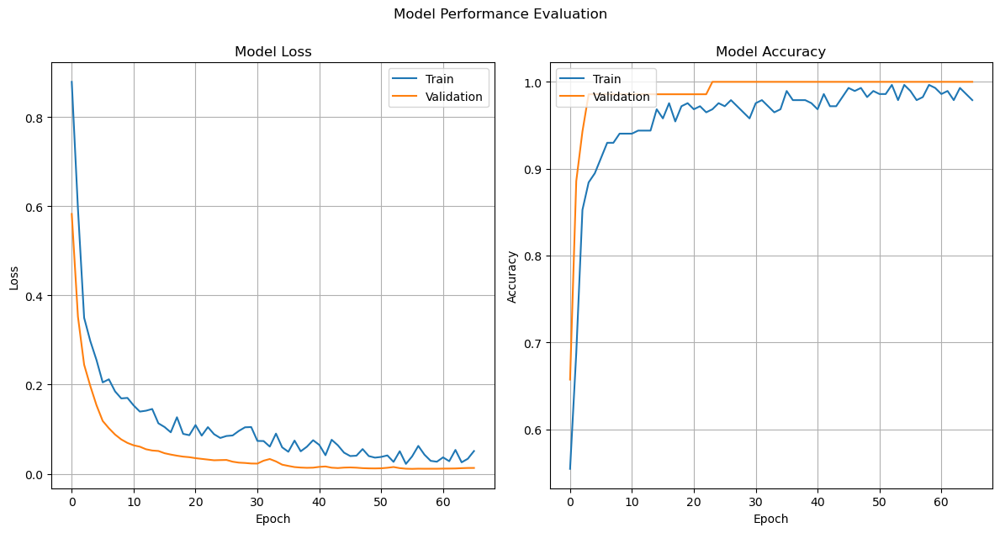

In [376]:
# figure
plt.figure(figsize=(12, 6))

# loss plot
plt.subplot(1, 2, 1)
sns.lineplot(data=history_model_tf.history, x=range(len(history_model_tf.history["loss"])), y="loss", label="Train")
sns.lineplot(data=history_model_tf.history, x=range(len(history_model_tf.history["val_loss"])), y="val_loss", label="Validation")
plt.title("Model Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend(loc="upper right")
plt.grid(True)

# accuracy plot
plt.subplot(1, 2, 2)
sns.lineplot(data=history_model_tf.history, x=range(len(history_model_tf.history["accuracy"])), y="accuracy", label="Train")
sns.lineplot(data=history_model_tf.history, x=range(len(history_model_tf.history["val_accuracy"])), y="val_accuracy", label="Validation")
plt.title("Model Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.legend(loc="upper left")
plt.grid(True)

plt.tight_layout()
plt.suptitle("Model Performance Evaluation", y=1.05)
plt.show()

insight:

- Model menunjukkan penurunan loss yang sangat cepat dalam beberapa epoch pertama. Pada training set, loss menurun secara konsisten dan terus stabil di sekitar nilai yang sangat rendah setelah sekitar 20 epoch. Pada validation set, loss juga menurun dengan cepat dan tetap rendah serta stabil setelah sekitar 10 epoch. Ini menunjukkan bahwa model dengan arsitektur MobileNetV2 mampu belajar dengan sangat cepat dan efektif dari data yang diberikan.

- Akurasi pada validation set dengan cepat mencapai nilai hampir sempurna (sekitar 100%) hanya dalam beberapa epoch pertama dan tetap stabil. Akurasi pada training set juga meningkat dengan cepat, mencapai lebih dari 95% setelah sekitar 20 epoch dan tetap stabil setelah itu.

- Ada sedikit perbedaan antara performa pada training set dan validation set, terutama setelah 20 epoch. Hal ini menunjukkan bahwa model tidak hanya belajar dengan baik pada data training tetapi juga mampu menggeneralisasi dengan sangat baik pada data yang tidak terlihat.

- Mengingat bahwa akurasi dan loss pada validation set sangat mirip dengan yang ada pada training set, ini menunjukkan bahwa model tidak mengalami overfitting yang signifikan. Biasanya, overfitting terjadi ketika performa pada training set jauh lebih baik dibandingkan dengan validation set, tetapi di sini kedua set menunjukkan performa yang hampir identik, yang menandakan model generalisasi yang baik.

- Model ini menunjukkan performa yang luar biasa baik dalam hal konvergensi yang cepat, generalisasi yang sangat baik, dan kemampuan untuk mempertahankan performa yang stabil di kedua set data. Model ini mampu mencapai akurasi hampir sempurna dalam jumlah epoch yang sangat sedikit, yang menunjukkan keefektifan dari pendekatan transfer learning untuk klasifikasi ini. Dibandingkan dengan model sebelumnya, model ini menawarkan performa yang jauh lebih baik, terutama dalam hal stabilitas dan kecepatan pembelajaran.

In [415]:
# load model_tf.keras
best_model_tf = tf.keras.models.load_model("deployment/model_tf.keras")

# check training accuracy and loss (training set)
train_loss_model_improved, train_acc_model_improved = best_model_tf.evaluate(train_generator)
print(f"Training loss: {train_loss_model_improved}")
print(f"Training accuracy: {train_acc_model_improved * 100:.2f}%")

# check test accuracy and loss (validation set)
test_loss_model_improved, test_acc_model_improved = best_model_tf.evaluate(val_generator)
print(f"Test loss: {test_loss_model_improved}")
print(f"Test accuracy: {test_acc_model_improved * 100:.2f}%")

2/2 ━━━━━━━━━━━━━━━━━━━━ 9s 188ms/step - accuracy: 0.9904 - loss: 0.0599
Training loss: 0.061234697699546814
Training accuracy: 98.95%
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 740ms/step - accuracy: 1.0000 - loss: 0.0304
Test loss: 0.030399248003959656
Test accuracy: 100.00%


insight:
- Model mencapai akurasi yang sangat tinggi sebesar 98.95% pada training set. Ini menunjukkan bahwa model sangat efektif dalam mempelajari pola dari data training, dengan kemampuan untuk mengklasifikasikan hampir semua gambar dengan benar.

- Nilai loss pada training set adalah 0.0599, yang sangat rendah. Ini menunjukkan bahwa model melakukan kesalahan prediksi yang sangat sedikit pada data training, yang konsisten dengan tingginya akurasi yang dicapai.

- Model mencapai akurasi sempurna sebesar 100.00% pada validation/test set, yang menunjukkan bahwa model mampu menggeneralisasi dengan sangat baik pada data yang tidak terlihat.

- Nilai loss pada validation/test set adalah 0.0304, yang bahkan lebih rendah daripada nilai loss pada training set. Ini menunjukkan bahwa model tidak hanya menguasai data training dengan sangat baik, tetapi juga mampu menangani data baru dengan hampir tidak ada kesalahan.

- Performa yang sangat mirip antara training dan validation set menunjukkan bahwa model tidak mengalami overfitting. Biasanya, overfitting terjadi ketika performa pada training set jauh lebih baik daripada pada validation set, tetapi di sini, kedua set menunjukkan performa yang sangat baik dan hampir identik.

2/2 ━━━━━━━━━━━━━━━━━━━━ 6s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 808ms/step
Classification Report - Train Set:
                         precision    recall  f1-score   support

Not Wearing Safety Gear       0.99      0.98      0.99       156
    Wearing Safety Gear       0.98      0.99      0.98       129

               accuracy                           0.99       285
              macro avg       0.99      0.99      0.99       285
           weighted avg       0.99      0.99      0.99       285

Classification Report - Validation Set:
                         precision    recall  f1-score   support

Not Wearing Safety Gear       1.00      1.00      1.00        38
    Wearing Safety Gear       1.00      1.00      1.00        32

               accuracy                           1.00        70
              macro avg       1.00      1.00      1.00        70
           weighted avg       1.00      1.00      1.00        70



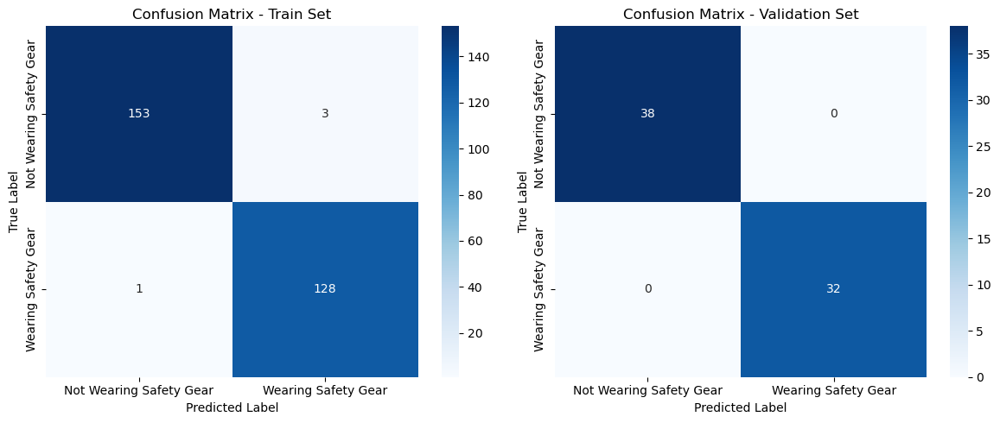

In [409]:
# predict training set
train_pred_prob = best_model_tf.predict(train_generator)
train_pred_class = (train_pred_prob > 0.5).astype("int32").flatten()

# predict validation set
test_pred_prob = best_model_tf.predict(val_generator)
test_pred_class = (test_pred_prob > 0.5).astype("int32").flatten()

# true labels
y_train_true = train_generator.classes
y_test_true = val_generator.classes

# classification_report train set
print("Classification Report - Train Set:")
print(classification_report(y_train_true, train_pred_class, target_names=list(train_generator.class_indices.keys())))

# classification_report validation set
print("Classification Report - Validation Set:")
print(classification_report(y_test_true, test_pred_class, target_names=list(val_generator.class_indices.keys())))

# confusion_matrix train set
cm_train = confusion_matrix(y_train_true, train_pred_class)

# confusion_matrix validation set
cm_test = confusion_matrix(y_test_true, test_pred_class)

# confusion matrix display
plt.figure(figsize=(12, 5))

# confusion matrix train set
plt.subplot(1, 2, 1)
sns.heatmap(cm_train, annot=True, fmt="d", cmap="Blues", xticklabels=list(train_generator.class_indices.keys()), yticklabels=list(train_generator.class_indices.keys()))
plt.title("Confusion Matrix - Train Set")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")

# confusion matrix validation set
plt.subplot(1, 2, 2)
sns.heatmap(cm_test, annot=True, fmt="d", cmap="Blues", xticklabels=list(val_generator.class_indices.keys()), yticklabels=list(val_generator.class_indices.keys()))
plt.title("Confusion Matrix - Validation Set")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")

plt.tight_layout()
plt.show()

insight:
- Semua metrik evaluasi (precision, recall, dan F1-score) memiliki nilai yang sangat tinggi, yaitu mendekati 1.0 untuk kedua kelas ("Not Wearing Safety Gear" dan "Wearing Safety Gear").

- Precision dan recall yang tinggi pada kedua kelas menunjukkan bahwa model hampir tidak membuat kesalahan klasifikasi, baik itu dalam bentuk false positives maupun false negatives.

- Confusion matrix pada set pelatihan menunjukkan bahwa model salah mengklasifikasikan 3 gambar dari "Not Wearing Safety Gear" ke "Wearing Safety Gear" dan 1 gambar dari "Wearing Safety Gear" ke "Not Wearing Safety Gear".

- Pada set validasi, model berhasil mengklasifikasikan semua gambar dengan benar tanpa kesalahan (0 false positives dan 0 false negatives).

- Model ini menunjukkan performa yang jauh lebih unggul dibandingkan dengan model-model sebelumnya, dengan akurasi yang hampir sempurna dan loss yang sangat rendah pada kedua set data. Tidak ada tanda-tanda overfitting atau underfitting, dan model ini sangat berhasil dalam mempelajari pola dari data training sekaligus menjaga kemampuan generalisasi yang sangat baik pada data yang tidak terlihat. Oleh karena itu, model ini merupakan model yang terbaik di antara ketiga model dan merupakan pilihan yang sangat kuat untuk digunakan pada inferencing.

# 8. Model Saving

Model dengan transfer learning menggunakan MobileNetV2 adalah yang terbaik di antara model lainnya. Model tersebut memberikan performa yang paling stabil dan akurat dengan waktu pelatihan yang lebih singkat, menunjukkan bahwa transfer learning adalah pendekatan yang sangat efektif untuk tugas klasifikasi yang dihadapi. Oleh karena itu, model yang akan disimpan dan digunakan untuk inferencing adalah model dengan transfer learning.

Proses penyimpanan model sudah dilakukan dengan metode ModelCheckpoint dari model terbaik pada proses train model transfer learning (model_tf). Berikut adalah summary dari model_tf yang telah disimpan.

In [410]:
# best val_loss
best_epoch_loss = np.argmin(history_model_tf.history["val_loss"])
best_val_loss = min(history_model_tf.history["val_loss"])
print(f"Best Epoch (Loss): {best_epoch_loss + 1} with val_loss: {best_val_loss:.4f}")

# best val_accuracy
best_epoch_acc = np.argmax(history_model_tf.history["val_accuracy"])
best_val_accuracy = max(history_model_tf.history["val_accuracy"])
print(f"Best Epoch (Accuracy): {best_epoch_acc + 1} with val_accuracy: {best_val_accuracy:.4f}")

Best Epoch (Loss): 56 with val_loss: 0.0112
Best Epoch (Accuracy): 24 with val_accuracy: 1.0000


In [411]:
# improved_model_2.keras summmary
model_inf = tf.keras.models.load_model("deployment/model_tf.keras")
model_inf.summary()

Model: "functional_901"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_31      │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer_31[0… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 3,242,565 (12.37 MB)

 Trainable params: 328,193 (1.25 MB)

 Non-trainable params: 2,257,984 (8.61 MB)

 Optimizer params: 656,388 (2.50 MB)

# 9. Model Inference

In [388]:
# path saved model
model_path = "deployment/model_tf.keras"

# load model
model = tf.keras.models.load_model(model_path)

# preprocessing parameter
target_size = (224, 224)
rescale = 1./255

# ImageDataGenerator preprocessing
infer_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=rescale
)

# images to test
img_paths = ["inf_images/istockphoto-173233703-612x612.jpg",
             "inf_images/E-505A8859-Large.jpeg",
             "inf_images/_131938505_ind3bc40c5f1c10d4248e6bf848ae7033c8814005e9-1.jpg",
             "inf_images/images.jpeg"]

# loop images
for img_path in img_paths:
    img = tf.keras.preprocessing.image.load_img(img_path, target_size=target_size)
    
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    
    img_array = infer_datagen.standardize(img_array)
    
    # predict
    prediction = model.predict(img_array)
    
    # predict result
    print(f"Prediction for {img_path}: {prediction}")
    if prediction[0] > 0.5:
        print(f"The image {img_path} \n is classified as Wearing Safety Gear.")
        print("")
    else:
        print(f"The image {img_path} \n is classified as Not Wearing Safety Gear.")
        print("")

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 686ms/step
Prediction for inf_images/istockphoto-173233703-612x612.jpg: [[0.9997344]]
The image inf_images/istockphoto-173233703-612x612.jpg 
 is classified as Wearing Safety Gear.

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Prediction for inf_images/E-505A8859-Large.jpeg: [[0.9980754]]
The image inf_images/E-505A8859-Large.jpeg 
 is classified as Wearing Safety Gear.

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Prediction for inf_images/_131938505_ind3bc40c5f1c10d4248e6bf848ae7033c8814005e9-1.jpg: [[0.00840772]]
The image inf_images/_131938505_ind3bc40c5f1c10d4248e6bf848ae7033c8814005e9-1.jpg 
 is classified as Not Wearing Safety Gear.

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Prediction for inf_images/images.jpeg: [[0.00671639]]
The image inf_images/images.jpeg 
 is classified as Not Wearing Safety Gear.



# 10. Conclusion

Model yang terlah dibuat untuk mendeteksi apakah pekerja menggunakan perlengkapan keselamatan dalam gambar telah mencapai akurasi yang sangat tinggi, yaitu 98.95% pada training set dan 100% pada validation set, dengan nilai loss yang rendah masing-masing sebesar 0.0599 dan 0.0304. Hal ini menunjukkan bahwa model tersebut telah berhasil mempelajari data pelatihan dengan efektif dan mampu melakukan generalisasi dengan baik pada data yang belum pernah dilihat sebelumnya. Kinerja yang konsisten pada training dan validation set mengindikasikan bahwa model ini tidak mengalami overfitting, sehingga dapat diandalkan dan siap untuk diterapkan dalam skenario dunia nyata.

Penerapan model ini dalam industri yang menekankan keselamatan, seperti konstruksi, manufaktur dan industri berat lainnya, dapat memberikan manfaat yang signifikan. Sistem otomatis yang dapat mendeteksi penggunaan perlengkapan keselamatan dapat membantu perusahaan meningkatkan kepatuhan terhadap peraturan keselamatan, mengurangi risiko kecelakaan kerja, dan pada akhirnya menurunkan biaya yang terkait dengan kecelakaan kerja dan asuransi. Selain itu, sistem ini juga dapat meningkatkan reputasi dan kepercayaan perusahaan di mata karyawan dan pelanggan.

Rekomendasi:

Model ini dapat diintegrasikan ke dalam sistem pengawasan yang ada atau aplikasi mobile untuk memastikan kepatuhan terhadap standar keselamatan secara real-time. Pelatihan kepada pengguna tentang cara menggunakan aplikasi berbasis model ini sangat penting untuk memastikan mereka dapat memanfaatkan fitur-fitur yang tersedia dengan baik. Pemantauan kinerja model secara berkala dan penyesuaian berdasarkan data baru juga akan membantu dalam menjaga relevansi dan akurasi model. Dengan integrasi ini, organisasi dapat lebih efektif mencapai tujuan keselamatan dan kepatuhan, serta memastikan lingkungan kerja yang lebih aman.

Meskipun model ini telah menunjukkan kinerja yang sangat baik, pemantauan secara terus-menerus sangat penting setelah diterapkan di lingkungan dunia nyata. Data dunia nyata sering kali lebih bervariasi dan kompleks dibandingkan dengan data pelatihan, sehingga kinerja model perlu dinilai secara berkala dan diperbarui sesuai kebutuhan. Jika model mulai menunjukkan tanda-tanda penurunan kinerja atau jika ada perubahan dalam lingkungan operasional (misalnya, jenis perlengkapan keselamatan baru) maka model perlu dilatih ulang dengan data baru untuk mempertahankan akurasi dan relevansinya. Meskipun model ini sudah dioptimalkan, pengujian lebih lanjut dengan teknik regularisasi tambahan, tuning hyperparameter, atau eksplorasi arsitektur model lain dapat dilakukan untuk melihat apakah masih ada ruang untuk perbaikan lebih lanjut.

Contoh untuk perbaikan lebih lanjut misalnya untuk memberikan data pelatihan gambar orang yang menggunakan helm selain helm untuk perlengkapan keselamatan karena berdasarkan hasil percobaan pada deployment, model mengklasifikasikan gambar orang yang menggunakan helm untuk bermotor, helm untuk bersepeda, helm untuk bermain skateboard atau helm lainnya ke dalam klasifikasi menggunakan perlengkapan keselamatan. Walaupun betul helm-helm tersebut mempunyai tujuan untuk keselamatan namun jika digunakan pada domain konstruksi, manufaktur dan industri berat lainnya klasifikasi tersebut kurang tepat. Hal tersebut diduga karena model tidak mendapatkan pelatihan bahwa gambar dengan helm-helm tersebut bukanlah masuk sebagai kategori "Wear Safety Gear" maka dari itu direkomendasikan untuk menambahkan gambar-gambar dengan helm-helm tersebut sebagai kategori "Not Wearing Safety Gear" dengan tujuan agar model mempelajari bahwa helm-helm tersebut bukanlah perlengkapan keselamatan.